# Libraries, figure parameters and custom functions

In [1]:
import scanpy as sc
import numpy as np
import pandas as pd
import anndata as ann
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import colors
from matplotlib import rcParams
#from gprofiler import gprofiler
import os
#import custom_functions as cf 
from sklearn.linear_model import LinearRegression

Add date.

In [2]:
from datetime import date

In [3]:
today = date.today().strftime("%y%m%d")

Add my color scheme.

In [4]:
colors2 = plt.cm.RdYlBu_r(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(0.7)
colorsComb = np.vstack([colors3, colors2])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

Set parameters for plots in scanpy

In [5]:
sc.settings.set_figure_params(dpi=80)

sc.set_figure_params(scanpy=True, dpi=80, dpi_save=250,
                     frameon=True, vector_friendly=True,
                     color_map='viridis', format='pdf', transparent=False,
                     ipython_format='png2x')

In [6]:
def cell_compo_table(adata, cluster, condition, xlabel='cell cluster',
                        ylabel='cell count', title=None, save=False):
    """
    """
    

    contingency_table = pd.crosstab(
        adata.obs[condition],
        adata.obs[cluster],
        margins = True
    )
    return(contingency_table)

def top_marker_as_xlsx(adata, key_rank_genes, key_groups, output_file):
    
    print(adata.uns[key_rank_genes].keys())
    dict_genes = adata.uns[key_rank_genes].copy()
    print(dict_genes['params'])
    del dict_genes['params']
    clusters = sorted(list(set(adata.obs[key_groups])))*len(dict_genes['scores'])
    for key, value in dict_genes.items():
        tmp_list = []
        for n in value:
            tmp_list = tmp_list + list(n)
        dict_genes[key] = tmp_list
    
    dict_genes['cluster'] = clusters

    dataframe = pd.DataFrame(dict_genes)
    dataframe.to_excel(output_file)
    return(dataframe)

# Load data

In [7]:
project_dir = '/lustre/groups/ml01/workspace/maren.buettner/Martinez_Liver_HPC/'

In [8]:
data_dir = project_dir + 'data/'
table_dir = project_dir + 'tables/'

In [9]:
adata_wt_young = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_young_cells_filtered_TPM_jul21_annotated.h5ad')
adata_wt_old = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_old_cells_filtered_TPM_jul21_annotated.h5ad')

In [10]:
adata_wt_young.var[['gene_name', 'mean_exp_TPM']].to_csv(table_dir + '220406_gene_mean_all.csv')

In [11]:
adata_young_HNF4 = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_young_HNF4-KO_filtered_TPM_jul21_annotated.h5ad')
adata_old_HNF4 = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_old_HNF4-KO_filtered_TPM_jul21_annotated.h5ad')
adata_young_CTCF = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_young_CTCF-KO_filtered_TPM_jul21_annotated.h5ad')
adata_old_CTCF = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_old_CTCF-KO_filtered_TPM_jul21_annotated.h5ad' )
adata_young_CEBPA = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_young_CEBPA-KO_filtered_TPM_jul21_annotated.h5ad')
adata_old_CEBPA = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_old_CEBPA-KO_filtered_TPM_jul21_annotated.h5ad')

We merge `adata_young` and `adata_old` in order to use the separately created cell type annotation.

In [12]:
adata_all = ann.concat([adata_wt_young, adata_wt_old, 
                        adata_young_HNF4, adata_old_HNF4,
                        adata_young_CTCF, adata_old_CTCF,
                        adata_young_CEBPA, adata_old_CEBPA,
                       ], index_unique=None)

In [13]:
adata_all.uns = adata_wt_young.uns
adata_all.varm = adata_wt_young.varm
adata_all.var['gene_name'] = adata_wt_young.var['gene_name']

Add covariate combining age and ploidy.

In [14]:
age_ploidy = [adata_all.obs['age_grouped'][idx] + ' ' + adata_all.obs['ploidy'][idx] for idx in range(adata_all.n_obs)]

In [15]:
adata_all.obs['age_ploidy'] = pd.Categorical(age_ploidy, categories=['young 2n', 'young 4n', 'old 2n', 'old 4n'])

Add strain information to the age and ploidy covariate.

In [16]:
strain_age_ploidy = [adata_all.obs['strain'][idx] + ' ' + 
                     adata_all.obs['age_grouped'][idx] + ' ' + 
                     adata_all.obs['ploidy'][idx] for idx in range(adata_all.n_obs)]

In [17]:
adata_all.obs['strain_age_ploidy'] = pd.Categorical(strain_age_ploidy, 
                                categories=['C57Bl6/J young 2n', 'C57Bl6/J young 4n', 
                                            'C57Bl6/J old 2n', 'C57Bl6/J old 4n',
                                            'HNF4 KO young 2n', 'HNF4 KO young 4n', 
                                            'HNF4 KO old 2n', 'HNF4 KO old 4n',
                                            'CEBPA KO young 2n', 'CEBPA KO young 4n', 
                                            'CEBPA KO old 2n', 'CEBPA KO old 4n',
                                            'CTCF KO young 2n', 'CTCF KO young 4n', 
                                            'CTCF KO old 2n', 'CTCF KO old 4n'
                                           ])

Add strain and age info as covariate.

In [18]:
strain_age = [adata_all.obs['strain'][idx] + ' ' + 
              adata_all.obs['age_grouped'][idx] for idx in range(adata_all.n_obs)]

In [19]:
adata_all.obs['strain_age'] = pd.Categorical(strain_age, 
                                categories=['C57Bl6/J young', 
                                            'C57Bl6/J old', 
                                            'HNF4 KO young', 
                                            'HNF4 KO old',
                                            'CEBPA KO young',
                                            'CEBPA KO old',
                                            'CTCF KO young',
                                            'CTCF KO old', 
                                           ])

Edit the raw object to use the gene symbols for plotting (e.g. in `stacked_violin` plot).

In [20]:
adata_all.raw.var['gene_name'] = adata_wt_young.var['gene_name']

Select hepatocytes.

In [21]:
adata_hep = adata_all[adata_all.obs['cell_type1']=='Hepatocytes'].copy()

In [22]:
adata_hep

AnnData object with n_obs × n_vars = 3969 × 30520
    obs: 'batch', 'exp.', 'libraryID', 'experiment', 'strain', 'age', 'sex', 'ploidy', 'ERCC.dilution', 'column', 'row', 'percentERCC', 'n_counts', 'age_grouped', 'n_counts_raw', 'n_counts_transcripts', 'n_counts_ERCC', 'n_genes', 'high_ERCC', 'low_ERCC', 'low_genes', 'high_genes', 'low_counts', 'high_counts', 'ERCC_size_factor', 'n_counts_TPM', 'RPK_factor', 'n_counts_TPM_norm', 'mean_transcript_count_TPM', 'cyclone_phases', 'score_G1', 'score_S', 'score_G2M', 'leiden_r1', 'leiden_r02', 'low_res_ct', 'clusters', 'score_Natural killer', 'score_Lymphocyte', 'score_Hepatoblast', 'score_Endothelial', 'score_Dendritic cell', 'score_B cells', 'score_Cholangiocyte', 'score_Kupffer and Macrophage', 'score_Hepatocyte', 'score_Neutrophil', 'leidenr02_02', 'cell_type', 'hblast_marker_sum', 'cell_type1', 'age_ploidy', 'strain_age_ploidy', 'strain_age'
    var: 'gene_name'
    uns: 'ERCC.dilution_colors', 'age_colors', 'age_grouped_colors', 'cell_t

## Read marker gene sets for visualisation

From our differential expression and gene set enrichment analysis, we have distilled several lists of genes to visualise the expression levels for.

In [23]:
#dotplot and violin plot
tfs_sharing_targets = pd.read_table(table_dir + 'Dotplot and violin plot_TFs sharing targets.csv', 
                                    sep=';', usecols=['Gene', 'Annotation'])
unchanged_age = pd.read_table(table_dir + 'Dotplot and violin plot_unchanged in age.csv', 
                              sep=';', usecols=['Genes', 'Annotation'])
unspec_liver = pd.read_table(table_dir + 'Dotplot and violin plot_unspecific to liver in age.csv', 
                             sep=';', usecols=['Gene', 'Annotation'])

#dotplot
old_hep = pd.read_table(table_dir + 'Dotplot_old hepatocytes.csv', 
                        sep=';', usecols=['Genes', 'Annotation', 'Annotation 2'])
young_hep = pd.read_table(table_dir + 'Dotplot_young hepatocytes.csv', 
                          sep=';', usecols=['Genes', 'Annotation'])


#heatmap plots
hm_conserved_old = pd.read_table(table_dir + 'Heatmap_conservation in old.csv', 
                                 sep=';', usecols=['Genes', 'Annotation'])
hm_conserved_young = pd.read_table(table_dir + 'Heatmap_conservation in young.csv', 
                                   sep=';', usecols=['Genes', 'Annotation'])
hm_unique_old = pd.read_table(table_dir + 'Heatmap_unique to old.csv', 
                              sep=';', usecols=['Genes', 'Annotation'])
hm_unique_young = pd.read_table(table_dir + 'Heatmap_unique to young.csv', 
                                sep=';', usecols=['Genes', 'Annotation'])

Some more markers.

In [24]:
tfs_sharing_filt = pd.read_table(table_dir + 'Downstream shared TFs.csv',sep=';', 
                                 usecols=['Gene', 'Annotation'])
tfs_sharing_filt2 = pd.read_table(table_dir + 'Downstream shared TFs_2.csv',sep=';', 
                                 usecols=['Genes', 'Annotation'])

Create marker gene dictionaries for each list (if applicable and filter out non-expressed genes). 

In [25]:
var_names = adata_all.var['gene_name']

In [26]:
tfs_sharing_targets['Annotation'] = tfs_sharing_targets['Annotation'].astype('category')

In [27]:
tfs_sharing_dict = {}
for m_key in tfs_sharing_targets['Annotation'].cat.categories:
    tmp_genes = list(tfs_sharing_targets[tfs_sharing_targets['Annotation']==m_key]['Gene'].values)
    tfs_sharing_dict[m_key] = [gene for gene in tmp_genes if np.in1d(gene, var_names)]

In [28]:
tfs_sharing_targets.loc[np.flatnonzero(np.invert(np.in1d(tfs_sharing_targets['Gene'], var_names)))]

,Gene,Annotation
51,Nkx2-1,shared with cebpa
72,Neurod1,shared with ctcf


In [29]:
[gene for gene in var_names if gene.startswith('Nkx')]

['Nkx6-2', 'Nkx2-6', 'Nkx2-2os']

In [30]:
[gene for gene in var_names if gene.startswith('Neuro')]

['Neurod4']

In [31]:
tfs_sharing_filt['Annotation'] = tfs_sharing_filt['Annotation'].astype('category')

In [32]:
tfs_sharing_filt_dict = {}
for m_key in tfs_sharing_filt['Annotation'].cat.categories:
    tmp_genes = list(tfs_sharing_filt[tfs_sharing_filt['Annotation']==m_key]['Gene'].values)
    tfs_sharing_filt_dict[m_key] = [gene for gene in tmp_genes if np.in1d(gene, var_names)]

In [33]:
tfs_sharing_filt.loc[np.flatnonzero(np.invert(np.in1d(tfs_sharing_filt['Gene'], var_names)))]

,Gene,Annotation
5,Csf3,Cebpb
15,Ptgs2,Cebpb
25,Cox2,Nfkb1
79,Cdn1a,Ep300
85,Ptgs2,Ep300
151,Cav3,Ppargc1a
153,Cyp11b2,Ppargc1a


In [34]:
tfs_sharing_filt2['Annotation'] = tfs_sharing_filt2['Annotation'].astype('category')

In [35]:
tfs_sharing_filt2_dict = {}
for m_key in tfs_sharing_filt2['Annotation'].cat.categories:
    tmp_genes = list(tfs_sharing_filt2[tfs_sharing_filt2['Annotation']==m_key]['Genes'].values)
    tfs_sharing_filt2_dict[m_key] = [gene for gene in tmp_genes if np.in1d(gene, var_names)]

In [36]:
tfs_sharing_filt2.loc[np.flatnonzero(np.invert(np.in1d(tfs_sharing_filt2['Genes'], var_names)))]

,Genes,Annotation


In [37]:
unchanged_age['Annotation'] = unchanged_age['Annotation'].astype('category')

In [38]:
unchanged_age_dict = {}
for m_key in unchanged_age['Annotation'].cat.categories:
    tmp_genes = list(unchanged_age[unchanged_age['Annotation']==m_key]['Genes'].values)
    unchanged_age_dict[m_key] = [gene for gene in tmp_genes if np.in1d(gene, var_names)]

In [39]:
unchanged_age.loc[np.flatnonzero(np.invert(np.in1d(unchanged_age['Genes'], var_names)))]

,Genes,Annotation


In [40]:
unspec_liver['Annotation'] = unspec_liver['Annotation'].astype('category')

In [41]:
unspec_liver_dict = {}
for m_key in unspec_liver['Annotation'].cat.categories:
    tmp_genes = list(unspec_liver[unspec_liver['Annotation']==m_key]['Gene'].values)
    unspec_liver_dict[m_key] = [gene for gene in tmp_genes if np.in1d(gene, var_names)]

In [42]:
unspec_liver.loc[np.flatnonzero(np.invert(np.in1d(unspec_liver['Gene'], var_names)))]

,Gene,Annotation


In [43]:
old_hep['Annotation'] = old_hep['Annotation'].astype('category')
old_hep['Annotation 2'] = old_hep['Annotation 2'].astype('category')

In [44]:
old_hep_dict = {}
old_hep_dict2 = {}
for m_key in old_hep['Annotation'].cat.categories:
    tmp_genes = list(old_hep[old_hep['Annotation']==m_key]['Genes'].values)
    old_hep_dict[m_key] = [gene for gene in tmp_genes if np.in1d(gene, var_names)]

for m_key in old_hep['Annotation 2'].cat.categories:
    tmp_genes = list(old_hep[old_hep['Annotation 2']==m_key]['Genes'].values)
    old_hep_dict2[m_key] = [gene for gene in tmp_genes if np.in1d(gene, var_names)]

In [45]:
old_hep.loc[np.flatnonzero(np.invert(np.in1d(old_hep['Genes'], var_names)))]

,Genes,Annotation,Annotation 2


In [46]:
young_hep['Annotation'] = young_hep['Annotation'].astype('category')

In [47]:
young_hep_dict = {}
for m_key in young_hep['Annotation'].cat.categories:
    tmp_genes = list(young_hep[young_hep['Annotation']==m_key]['Genes'].values)
    young_hep_dict[m_key] = [gene for gene in tmp_genes if np.in1d(gene, var_names)]

In [48]:
young_hep.loc[np.flatnonzero(np.invert(np.in1d(young_hep['Genes'], var_names)))]

,Genes,Annotation
22,Slc55e2,transporter
60,Zl1r1,overlap with ctcf cell division
73,Hsd17b,overlap with ctcf liver specific


Closest matches for 'Slc55a2' are 'Slc35e2' and 'Slc52e3'.

In [49]:
[gene for gene in var_names if gene.endswith('r1') and gene.startswith('Z')]

['Zpr1', 'Zer1', 'Zrsr1', 'Zar1']

Closest matches for 'Zl1r1' are 'Zpr1', 'Zer1', 'Zrsr1' and 'Zar1'.

In [50]:
[gene for gene in var_names if gene.startswith('Hsd17b')]

['Hsd17b1',
 'Hsd17b4',
 'Hsd17b10',
 'Hsd17b6',
 'Hsd17b7',
 'Hsd17b12',
 'Hsd17b11',
 'Hsd17b14',
 'Hsd17b2',
 'Hsd17b3',
 'Hsd17b13']

Closest matches for 'Hsd17b' is an entire family of genes ('Hsd17b1',
 'Hsd17b4',
 'Hsd17b10',
 'Hsd17b6',
 'Hsd17b7',
 'Hsd17b12',
 'Hsd17b11',
 'Hsd17b14',
 'Hsd17b2',
 'Hsd17b3' and
 'Hsd17b13')

In [51]:
hm_conserved_old['Annotation'] = hm_conserved_old['Annotation'].astype('category')

In [52]:
hm_conserved_old_dict = {}
for m_key in hm_conserved_old['Annotation'].cat.categories:
    tmp_genes = list(hm_conserved_old[hm_conserved_old['Annotation']==m_key]['Genes'].values)
    hm_conserved_old_dict[m_key] = [gene for gene in tmp_genes if np.in1d(gene, var_names)]

In [53]:
hm_conserved_old.loc[np.flatnonzero(np.invert(np.in1d(hm_conserved_old['Genes'], var_names)))]

,Genes,Annotation


In [54]:
hm_conserved_young['Annotation'] = hm_conserved_young['Annotation'].astype('category')

In [55]:
len(hm_conserved_young)

417

Pre-filter the `hm_conserved_young` group for minimum expression.

In [56]:
adata_hep.var['gene_mean'] = np.mean(adata_hep.X, axis=0)

In [57]:
var_names_filt = var_names[adata_hep.var['gene_mean']>0.15]

In [58]:
hm_conserved_young_dict = {}
for m_key in hm_conserved_young['Annotation'].cat.categories:
    tmp_genes = list(hm_conserved_young[hm_conserved_young['Annotation']==m_key]['Genes'].values)
    hm_conserved_young_dict[m_key] = [gene for gene in tmp_genes if np.in1d(gene, var_names_filt)]

In [59]:
hm_conserved_young.loc[np.flatnonzero(np.invert(np.in1d(hm_conserved_young['Genes'], var_names_filt)))]

,Genes,Annotation
3,Hsd3b5,highly conserved
4,Hsdl2,highly conserved
14,Zkscan1,liver conserved
15,Zfp281,liver conserved
18,Dnajb11,liver conserved
...,...,...
410,Slc25a30,liver unspecific
411,Atl2,liver unspecific
413,Ganab,liver unspecific
415,Fopnl,liver unspecific


In [60]:
hm_unique_old['Annotation'] = hm_unique_old['Annotation'].astype('category')

In [61]:
len(hm_unique_old)

798

In [62]:
hm_unique_old_dict = {}
for m_key in hm_unique_old['Annotation'].cat.categories:
    tmp_genes = list(hm_unique_old[hm_unique_old['Annotation']==m_key]['Genes'].values)
    hm_unique_old_dict[m_key] = [gene for gene in tmp_genes if np.in1d(gene, var_names_filt)]

In [63]:
hm_unique_old.loc[np.flatnonzero(np.invert(np.in1d(hm_unique_old['Genes'], var_names_filt)))]

,Genes,Annotation
0,Anks4b,old wt
2,Lsr,old wt
3,Orm3,old wt
4,Zfp354b,old wt
5,Olfr1338,old wt
...,...,...
792,Foxred1,old ctcf
793,Vps9d1,old ctcf
794,Pafah2,old ctcf
795,Rfxank,old ctcf


Closest match to 'Mar 02' is 'Marchf2'.

In [64]:
hm_unique_young['Annotation'] = hm_unique_young['Annotation'].astype('category')

In [65]:
len(hm_unique_young)

1134

In [66]:
hm_unique_young_dict = {}
for m_key in hm_unique_young['Annotation'].cat.categories:
    tmp_genes = list(hm_unique_young[hm_unique_young['Annotation']==m_key]['Genes'].values)
    hm_unique_young_dict[m_key] = [gene for gene in tmp_genes if np.in1d(gene, var_names_filt)]

In [67]:
hm_unique_young.loc[np.flatnonzero(np.invert(np.in1d(hm_unique_young['Genes'], 
                                                     var_names_filt)))]

,Genes,Annotation
3,Exph5,young wt
4,C1ra,young wt
5,Zfp330,young wt
6,Setd6,young wt
7,Fbxo22,young wt
...,...,...
1128,Hdhd3,young ctcf
1129,Fzd6,young ctcf
1131,Mrps5,young ctcf
1132,Ncln,young ctcf


Read in curated list of unchanged genes from Kelvin. 

In [68]:
unchanged_genes = pd.read_csv(table_dir + 'Unchanged genes.csv')

Read markers from DE gene list curated by Kelvin in Jan '22.

In [69]:
old_exp = pd.read_table(table_dir + 'DEGs_old_exp.csv',sep=';', 
                                 usecols=['Gene', 'Annotation'])
DE_4n_changes = pd.read_table(table_dir + 'DEGs_4n_changes.csv',sep=';', 
                                 usecols=['Gene', 'Annotation'])
old_nuc = pd.read_table(table_dir + 'DEGs_old_nuclei.csv',sep=';', 
                                 usecols=['Gene', 'Annotation'])

Read in Hnf4a, Cebpa related KEGG pathways.

In [70]:
kegg_select = pd.read_csv(table_dir + '220404_arcplot_genes.csv').T[0].values

In [71]:
kegg_select[:5]

array(['ENSMUSG00000060534', 'ENSMUSG00000031628', 'ENSMUSG00000028914',
       'ENSMUSG00000040760', 'ENSMUSG00000000303'], dtype=object)

Read in Hnf4a and Cebpa related gene pathways for the arc plot of young vs old WT hepatocytes.

In [72]:
arc_select = pd.read_csv(table_dir + 'List_for Arc plot.csv', index_col=0, sep=';')

In [73]:
arc_select

,Annotation
Gene,
Aadac,Lipolysis
Abcd11,Lipolysis
Abhd2,Lipolysis
Aacaa1a,Lipolysis
Acaa2,Lipolysis
...,...
Alb,Growth
Glb1,Senescence
Cdkn2a,Senescence


Some more ageing genes.

In [74]:
age_increase = pd.read_csv(table_dir + 'List_Age_increase.csv', sep=';')

In [75]:
age_increase['Genes'].values

array(['Hoxd10', 'Thy1', 'Tmem179', 'Lrp5', 'Gal3st3', 'Ids', 'Pcdhga11',
       'Acat3', 'Actg1', 'Rbbp4', 'Erp27', 'Tgfb1', 'Slc10a1', 'Dok2',
       'Usp12', 'Actn1', 'Cxxc5', 'Psmb8', 'Gpnmb', 'Tspo', 'Irf7',
       'Icam1', 'Ms4a6a', 'Isg15', 'C4b', 'C4a', 'Cebpb', 'Tap1', 'Psmb9',
       'Itgb2', 'Gbp6', 'Ifi47', 'Lgals3bp', 'Adora1', 'Tnfrsf12a',
       'Abca8', 'Sirpa', 'Cd44', 'B4galt5', 'Anxa2', 'Tifa', 'Laptm5',
       'Rhbdf2', 'Cp', 'Hmox1', 'Zfp703', 'Tgif1', 'Klf6', 'Cd53',
       'Tubb6', 'PVR', 'Nfkb2', 'Slc6a9', 'Rps16', 'Mthfd1l', 'Stat3',
       'Nfkbie', 'Slfn13', 'Micall2', 'Pik3r5', 'Relt', 'Ifi27l2b',
       'Slc39a6', 'Atp8b4', 'Gbp5', 'Relb', 'Casp4', 'Itgax', 'Cd68',
       'Plp2', 'Junb', 'Fcgr2a', 'Stap2', 'Cyp3a11', 'Cyp2e1', 'Apoa2',
       'Apoc3', 'Serpine1e', 'Mup3', 'Mup20', 'Slfn4', 'Pla1a', 'Myo1g',
       'Trim24', 'Rnd1', 'Klra17', 'Ly49si1', 'Rasa4', 'Itga4', 'Pik3ap1',
       'Pik3cd', 'Tpm1', 'Acss2', 'Mcp1', 'Myo5a', 'Cdkn2a', 'Cxcl2',
       

In [76]:
age_decrease = pd.read_csv(table_dir + 'List_Age_decrease.csv', sep=';')

In [77]:
age_decrease['Decrease'].values

array(['Ege', 'Egf10', 'Hgf', 'Wnt', 'Rspo1', 'Gast', 'Nog', 'Pge2',
       'Lgr5', 'Fgf1', 'Fgf2', 'Nrf2', 'Gclc', 'Gclm', 'Txn1', 'Txnrd1',
       'Tm9sf2', 'Cd164', 'Ddx5', 'P4hb', 'Lars2', 'Apom', 'Cisd2',
       'Cyp2c38', 'Tbxas1', 'Ptgis', 'Cyp4f15', 'Ces1e', 'Ces3a', 'Gstp1',
       'Mgst1', 'Ugt2b1', 'Cyp3a11', 'Alas2', 'Serpina3k', 'Cyp4a12b',
       'Inmt', 'Cat'], dtype=object)

Marker gene set from KO for violin plots.

In [79]:
up_4n_hemi_ko = pd.read_table(table_dir + 'List_up in 4n hemizygous KOs.csv',sep=';')
up_hemi_ko = pd.read_table(table_dir + 'List_up in hemizygous KOs.csv',sep=';')

In [82]:
up_hemi_ko['Gene'][np.invert(np.in1d(up_hemi_ko['Gene'], adata_hep.var['gene_name']))]

126    Upt1a1
Name: Gene, dtype: object

In [83]:
up_4n_hemi_ko['Annotation'] = up_4n_hemi_ko['Annotation'].astype('category')
up_hemi_ko['Annotation'] = up_hemi_ko['Annotation'].astype('category')

In [84]:
up_4n_hemi_dict = {}
for m_key in up_4n_hemi_ko['Annotation'].cat.categories:
    tmp_genes = list(up_4n_hemi_ko[up_4n_hemi_ko['Annotation']==m_key]['Gene'].values)
    up_4n_hemi_dict[m_key] = [gene for gene in tmp_genes if np.in1d(gene, var_names_filt)]

In [85]:
up_hemi_dict = {}
for m_key in up_hemi_ko['Annotation'].cat.categories:
    tmp_genes = list(up_hemi_ko[up_hemi_ko['Annotation']==m_key]['Gene'].values)
    up_hemi_dict[m_key] = [gene for gene in tmp_genes if np.in1d(gene, var_names_filt)]

Plot as:
1. Dot plot (young and old, no ploidy separation for all strains)
2. Violin plot (2n and 4n in both young and old for all strains)
3. Give up p value, in a table by comparing the KO against WT?

# Introduction

In this notebook, we create visualisations of the analyses of the hepatocyte population. Specifically, we visualise 

0. co-expression computation for Hnf4a and Cebpa KEGG terms
1. marker gene expression grouped by age and strain
2. marker gene expression as violin ploits for ploidy
3. t-SNE plots for young and old and selected strains
4. heatmap plots for selected genes


# Co-coexpression analysis for Hnf4a and Cebpa

In [104]:
adata_sel_young = adata_wt_young[:, np.in1d(adata_wt_young.var['gene_name'],arc_select.index)].copy()
adata_sel_young = adata_sel_young[adata_sel_young.obs['cell_type1']=='Hepatocytes']

In [105]:
adata_sel_young.var['gene_mean_hep'] = adata_sel_young.layers['norm_counts'].mean(axis=0)

Trying to set attribute `.var` of view, copying.


In [103]:
arc_select[np.invert(np.in1d(arc_select.index, adata_sel_young.var['gene_name']))]

,Annotation
Gene,
Abcd11,Lipolysis
Aacaa1a,Lipolysis
Gpi,Gluconeogenesis
Cyp2a6,Drug metabolism
Cyp4f12,Drug metabolism
Cyp2b6,Drug metabolism
Oatp1a4,Drug metabolism
Ugt1a6,Drug metabolism
Mrp4,Drug metabolism


In [46]:
'Nr1i2' in adata_wt_young.var['gene_name'].values

True

In [58]:
np.sort([gene for gene in adata_wt_young.var['gene_name'].values if gene.startswith('Cyp') ])

array(['Cyp11a1', 'Cyp11b1', 'Cyp17a1', 'Cyp19a1', 'Cyp1a1', 'Cyp1a2',
       'Cyp1b1', 'Cyp20a1', 'Cyp21a1', 'Cyp21a2-ps', 'Cyp24a1', 'Cyp26a1',
       'Cyp26b1', 'Cyp26c1', 'Cyp27a1', 'Cyp2a12', 'Cyp2a21-ps',
       'Cyp2a22', 'Cyp2a4', 'Cyp2a5', 'Cyp2ab1', 'Cyp2b10', 'Cyp2b13',
       'Cyp2b23', 'Cyp2b27-ps', 'Cyp2b9', 'Cyp2c23', 'Cyp2c29', 'Cyp2c37',
       'Cyp2c38', 'Cyp2c39', 'Cyp2c40', 'Cyp2c50', 'Cyp2c52-ps',
       'Cyp2c53-ps', 'Cyp2c54', 'Cyp2c55', 'Cyp2c65', 'Cyp2c66',
       'Cyp2c67', 'Cyp2c68', 'Cyp2c69', 'Cyp2c70', 'Cyp2d10', 'Cyp2d11',
       'Cyp2d12', 'Cyp2d22', 'Cyp2d26', 'Cyp2d37-ps', 'Cyp2d40',
       'Cyp2d41-ps', 'Cyp2d9', 'Cyp2e1', 'Cyp2f2', 'Cyp2g1', 'Cyp2j11',
       'Cyp2j12', 'Cyp2j13', 'Cyp2j14-ps', 'Cyp2j15-ps', 'Cyp2j5',
       'Cyp2j6', 'Cyp2j7', 'Cyp2j8', 'Cyp2j9', 'Cyp2r1', 'Cyp2s1',
       'Cyp2t4', 'Cyp2u1', 'Cyp39a1', 'Cyp3a11', 'Cyp3a13', 'Cyp3a16',
       'Cyp3a25', 'Cyp3a44', 'Cyp3a57', 'Cyp3a59', 'Cyp3a61-ps1',
       'Cyp3a63-ps', 'Cyp46a1', 

In [24]:
import itertools
import json

Let us use the normalised mutual information to assess co-expression. It ranges from 0 (no mutual information) to 1 (perfect correlation).

In [107]:
from sklearn.metrics import normalized_mutual_info_score as nmi

In [108]:
co_expression = dict()
for pair in itertools.combinations(adata_sel_young.var_names, 2):
    is_expr_A = adata_sel_young.layers['norm_counts'][:, 
                                            adata_sel_young.var_names==pair[0]]>0
    is_expr_B = adata_sel_young.layers['norm_counts'][:, 
                                            adata_sel_young.var_names==pair[1]]>0
    #is_co_expr = np.logical_and(is_expr_A, is_expr_B).flatten()
    #is_expr = np.invert(np.logical_or(is_expr_A, is_expr_B).flatten())
    #scale denominator by the number of cells that express the pair of genes
    #co_expression['-'.join(pair)] = is_co_expr.sum()/(len(is_expr) - is_expr.sum())
    co_expression['-'.join(pair)] = nmi(is_expr_A.flatten(), is_expr_B.flatten())

Write co-expression result to json file.

In [110]:
with open(table_dir + today + '_co_expression_wt_young.json', 'w') as f:
    json.dump(co_expression,f)

Save mean gene expression to table.

In [111]:
adata_sel_young.var['gene_mean_hep'].to_csv(table_dir +today + '_mean_expression_hep_wt_young.csv')

Repeat for old mice data.

In [115]:
adata_sel_old = adata_wt_old[:, np.in1d(adata_wt_old.var['gene_name'], arc_select.index)].copy()
adata_sel_old = adata_sel_old[adata_sel_old.obs['cell_type1']=='Hepatocytes']

In [116]:
adata_sel_old.var['gene_mean_hep'] = adata_sel_old.layers['norm_counts'].mean(axis=0)

Trying to set attribute `.var` of view, copying.


In [118]:
co_expression = dict()
for pair in itertools.combinations(adata_sel_old.var_names, 2):
    is_expr_A =adata_sel_old.layers['norm_counts'][:, 
                                            adata_sel_old.var_names==pair[0]]>0
    is_expr_B =adata_sel_old.layers['norm_counts'][:, 
                                            adata_sel_old.var_names==pair[1]]>0
    #is_co_expr = np.logical_and(is_expr_A, is_expr_B).flatten()
    #is_expr = np.invert(np.logical_or(is_expr_A, is_expr_B).flatten())
    #scale denominator by the number of cells that express the pair of genes
    #co_expression['-'.join(pair)] = is_co_expr.sum()/(len(is_expr) - is_expr.sum())
    co_expression['-'.join(pair)] = nmi(is_expr_A.flatten(), is_expr_B.flatten())

Write co-expression result to json file.

In [119]:
with open(table_dir + today + '_co_expression_wt_old.json', 'w') as f:
    json.dump(co_expression,f)

Save mean gene expression to table.

In [120]:
adata_sel_old.var['gene_mean_hep'].to_csv(table_dir + today + '_mean_expression_hep_wt_old.csv')

Next, we compute the co-expression patterns for 2n and 4n hepatocytes separately and for all strains.

In [95]:
import itertools
import json
from sklearn.metrics import normalized_mutual_info_score as nmi

for ploidy_key in ['2n', '4n']:
    for strain_key in adata_hep.obs['strain'].cat.categories:
        key_young = f'{strain_key} young {ploidy_key}'
        key_old = f'{strain_key} old {ploidy_key}'
        st_key_out = strain_key.replace('/', '')
        adata_tmp_young = adata_hep[adata_hep.obs['strain_age_ploidy']==key_young].copy() 
        adata_tmp_old = adata_hep[adata_hep.obs['strain_age_ploidy']==key_old].copy() 
        
        #select arc plot genes
        adata_tmp_young = adata_tmp_young[:, np.in1d(adata_tmp_young.var['gene_name'],arc_select.index)].copy()
        adata_tmp_old = adata_tmp_old[:, np.in1d(adata_tmp_old.var['gene_name'],arc_select.index)].copy()
        
        #compute mean expression
        adata_tmp_young.var['gene_mean_hep'] = adata_tmp_young.layers['norm_counts'].mean(axis=0)
        adata_tmp_old.var['gene_mean_hep'] = adata_tmp_old.layers['norm_counts'].mean(axis=0)
        
        #write mean expression to file
        adata_tmp_young.var['gene_mean_hep'].to_csv(table_dir + today + f'_mean_expression_hep_{st_key_out}_young_{ploidy_key}.csv')
        adata_tmp_old.var['gene_mean_hep'].to_csv(table_dir + today + f'_mean_expression_hep_{st_key_out}_old_{ploidy_key}.csv')
        
        #compute co-expression as NMI
        co_expression = dict()
        for pair in itertools.combinations(adata_tmp_young.var_names, 2):
            is_expr_A = adata_tmp_young.layers['norm_counts'][:, 
                                            adata_tmp_young.var_names==pair[0]]>0
            is_expr_B = adata_tmp_young.layers['norm_counts'][:, 
                                            adata_tmp_young.var_names==pair[1]]>0
    
            co_expression['-'.join(pair)] = nmi(is_expr_A.flatten(), is_expr_B.flatten())
        
        #write co-expression to file
        with open(table_dir + today + f'_co_expression_{st_key_out}_young_{ploidy_key}.json', 'w') as f:
            json.dump(co_expression,f)
        
        #compute co-expression as NMI
        co_expression = dict()
        for pair in itertools.combinations(adata_tmp_old.var_names, 2):
            is_expr_A = adata_tmp_old.layers['norm_counts'][:, 
                                            adata_tmp_old.var_names==pair[0]]>0
            is_expr_B = adata_tmp_old.layers['norm_counts'][:, 
                                            adata_tmp_old.var_names==pair[1]]>0
    
            co_expression['-'.join(pair)] = nmi(is_expr_A.flatten(), is_expr_B.flatten())
        #write co-expression to file
        with open(table_dir + today + f'_co_expression_{st_key_out}_old_{ploidy_key}.json', 'w') as f:
            json.dump(co_expression,f)

In [96]:
import itertools
import json
from sklearn.metrics import normalized_mutual_info_score as nmi


for strain_key in adata_hep.obs['strain'].cat.categories:
    key_young = f'{strain_key} young'
    key_old = f'{strain_key} old'
    st_key_out = strain_key.replace('/', '')
    adata_tmp_young = adata_hep[adata_hep.obs['strain_age']==key_young].copy() 
    adata_tmp_old = adata_hep[adata_hep.obs['strain_age']==key_old].copy() 
        
    #select arc plot genes
    adata_tmp_young = adata_tmp_young[:, np.in1d(adata_tmp_young.var['gene_name'],arc_select.index)].copy()
    adata_tmp_old = adata_tmp_old[:, np.in1d(adata_tmp_old.var['gene_name'],arc_select.index)].copy()
        
    #compute mean expression
    adata_tmp_young.var['gene_mean_hep'] = adata_tmp_young.layers['norm_counts'].mean(axis=0)
    adata_tmp_old.var['gene_mean_hep'] = adata_tmp_old.layers['norm_counts'].mean(axis=0)
        
    #write mean expression to file
    adata_tmp_young.var['gene_mean_hep'].to_csv(table_dir + today + f'_mean_expression_hep_{st_key_out}_young.csv')
    adata_tmp_old.var['gene_mean_hep'].to_csv(table_dir + today + f'_mean_expression_hep_{st_key_out}_old.csv')
        
    #compute co-expression as NMI
    co_expression = dict()
    for pair in itertools.combinations(adata_tmp_young.var_names, 2):
        is_expr_A = adata_tmp_young.layers['norm_counts'][:, 
                                            adata_tmp_young.var_names==pair[0]]>0
        is_expr_B = adata_tmp_young.layers['norm_counts'][:, 
                                            adata_tmp_young.var_names==pair[1]]>0
    
        co_expression['-'.join(pair)] = nmi(is_expr_A.flatten(), is_expr_B.flatten())
        
    #write co-expression to file
    with open(table_dir + today + f'_co_expression_{st_key_out}_young.json', 'w') as f:
        json.dump(co_expression,f)
        
    #compute co-expression as NMI
    co_expression = dict()
    for pair in itertools.combinations(adata_tmp_old.var_names, 2):
        is_expr_A = adata_tmp_old.layers['norm_counts'][:, 
                                            adata_tmp_old.var_names==pair[0]]>0
        is_expr_B = adata_tmp_old.layers['norm_counts'][:, 
                                            adata_tmp_old.var_names==pair[1]]>0
    
        co_expression['-'.join(pair)] = nmi(is_expr_A.flatten(), is_expr_B.flatten())
    #write co-expression to file
    with open(table_dir + today + f'_co_expression_{st_key_out}_old.json', 'w') as f:
        json.dump(co_expression,f)

# Matrix plots 

Plot the differentially expressed genes ignoring the ploidy, separate by strain and age.

In [69]:
adata_hep

AnnData object with n_obs × n_vars = 3969 × 30520
    obs: 'batch', 'exp.', 'libraryID', 'experiment', 'strain', 'age', 'sex', 'ploidy', 'ERCC.dilution', 'column', 'row', 'percentERCC', 'n_counts', 'age_grouped', 'n_counts_raw', 'n_counts_transcripts', 'n_counts_ERCC', 'n_genes', 'high_ERCC', 'low_ERCC', 'low_genes', 'high_genes', 'low_counts', 'high_counts', 'ERCC_size_factor', 'n_counts_TPM', 'RPK_factor', 'n_counts_TPM_norm', 'mean_transcript_count_TPM', 'cyclone_phases', 'score_G1', 'score_S', 'score_G2M', 'leiden_r1', 'leiden_r02', 'low_res_ct', 'clusters', 'score_Natural killer', 'score_Lymphocyte', 'score_Hepatoblast', 'score_Endothelial', 'score_Dendritic cell', 'score_B cells', 'score_Cholangiocyte', 'score_Kupffer and Macrophage', 'score_Hepatocyte', 'score_Neutrophil', 'leidenr02_02', 'cell_type', 'hblast_marker_sum', 'cell_type1', 'age_ploidy', 'strain_age_ploidy', 'strain_age'
    var: 'gene_name', 'gene_mean'
    uns: 'ERCC.dilution_colors', 'age_colors', 'age_grouped_col

## Heatmap/Matrix plot

Show genes that are upregulated in old nuclei, taking into account DEG by their mean expression, with no separation on ploidy. Data named **DEGs_old_exp**. 

**Task:** Order the gene list by the p-value per group in the test "strain" young vs old. 

In [70]:
test_name = '210906_DE_test_young_vs_old_HNF4 KO_Hepatocytes_gene_expression_filter25.csv'

In [71]:
test_name.split('_')

['210906',
 'DE',
 'test',
 'young',
 'vs',
 'old',
 'HNF4 KO',
 'Hepatocytes',
 'gene',
 'expression',
 'filter25.csv']

In [72]:
all_tables = os.listdir(table_dir)
table_list = dict()
for table in all_tables:
    if table.count("_DE_test_young_vs_old_")>0 and table.count("_Hepatocytes_")>0:
        print(table)
        if table.startswith('2109'):
            table_tmp = pd.read_csv(table_dir + table, index_col=0)
            table_name = table.split('_')[6]
            table_list[table_name] = table_tmp

210906_DE_test_young_vs_old_HNF4 KO_Hepatocytes_gene_expression_filter25.csv
210329_DE_test_young_vs_old_C57Bl6J_Hepatocytes_gene_expression_filter25.csv
210407_DE_test_young_vs_old_HNF4 KO_Hepatocytes_gene_expression_filter25.csv
210329_DE_test_young_vs_old_CTCF KO_Hepatocytes_gene_expression_filter25.csv
210329_DE_test_young_vs_old_CEBPA KO_Hepatocytes_gene_expression_filter25.csv
210329_DE_test_young_vs_old_HNF4 KO_Hepatocytes_gene_expression_filter25.csv
210407_DE_test_young_vs_old_C57Bl6J_Hepatocytes_gene_expression_filter25.csv
210407_DE_test_young_vs_old_CEBPA KO_Hepatocytes_gene_expression_filter25.csv
210906_DE_test_young_vs_old_C57Bl6J_Hepatocytes_gene_expression_filter25.csv
210906_DE_test_young_vs_old_CTCF KO_Hepatocytes_gene_expression_filter25.csv
210906_DE_test_young_vs_old_CEBPA KO_Hepatocytes_gene_expression_filter25.csv
210407_DE_test_young_vs_old_CTCF KO_Hepatocytes_gene_expression_filter25.csv


In [73]:
old_exp.head()

,Gene,Annotation
0,Golgb1,whcct_exp
1,Zfp395,whcct_exp
2,Noct,whcct_exp
3,Smad6,whc_exp
4,Tlcd1,wh_exp


The annotation is the following:
* 'w' - wild type
* 'h' - Hnf4 KO
* 'c' - Cebpa KO
* 'ct' - CTCF KO

We split the table based on the annotation. Some genes are in both groups. Further, we have to combine them with the differential expression test results.

In [74]:
old_exp.Annotation.value_counts()

c_exp        57
ct_exp       56
h_exp        46
w_exp        13
wh_exp        6
whcct_exp     3
wc_exp        1
whc_exp       1
Name: Annotation, dtype: int64

Split the gene list by group.

In [75]:
all_genes = list()
wt_genes = list()
hnf_genes = list()
cebpa_genes = list()
ctcf_genes = list()

for idx in old_exp.index:
    #get annotation
    gene, anno = old_exp.iloc[idx].values
    if anno.startswith('w'):
        wt_genes.append(gene)
    if anno.count('h')>0:
        hnf_genes.append(gene)    
    if anno.count('c_'):
        cebpa_genes.append(gene)
    if anno.count('ct_'):
        ctcf_genes.append(gene)
    if anno.count('whcct_'):
        all_genes.append(gene)

In [76]:
table_list.keys()

dict_keys(['HNF4 KO', 'C57Bl6J', 'CTCF KO', 'CEBPA KO'])

In [77]:
gene_dict = {'C57Bl6/J': wt_genes, 
             'HNF4 KO': hnf_genes,
             'CTCF KO': ctcf_genes,
             'CEBPA KO': cebpa_genes,
             'All': all_genes
            }

Create matrixplot with custom logFC normalisation of the data, plot Y - O as columns per strain.

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  __ = ax.pcolor(_color_df, **kwds)


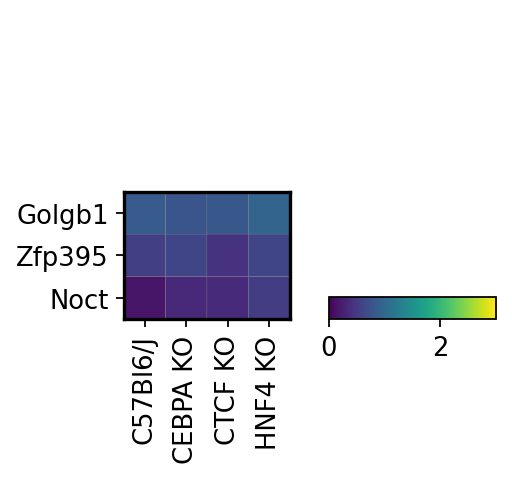

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  __ = ax.pcolor(_color_df, **kwds)


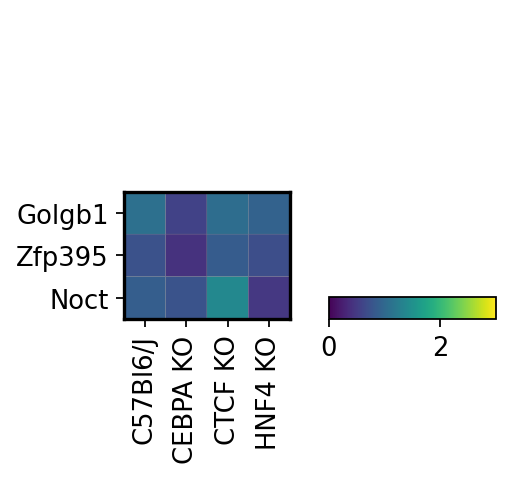

In [92]:
#plot all genes
for idx, age in enumerate(['young', 'old']):
    #plot matrixplot, one for young, one for old
    sc.pl.matrixplot(adata_hep[adata_hep.obs['age_grouped']==age].copy(),
                     groupby = 'strain',
                     var_names = gene_dict['All'],
                     gene_symbols = 'gene_name',
                     swap_axes = True,
                      vmax = 3, vmin = 0,
                     #ax = axs[0,idx],
                     #show=False, 
                      colorbar_title = '',
                     
                     save = today + '_DEG_old_' + 'all-genes' + '_' + age + '.pdf'
                    )

Create matrix plots sorted by mean expression per strain.

In [93]:
adata_hep.n_vars

30520

In [94]:
adata_hep

AnnData object with n_obs × n_vars = 3969 × 30520
    obs: 'batch', 'exp.', 'libraryID', 'experiment', 'strain', 'age', 'sex', 'ploidy', 'ERCC.dilution', 'column', 'row', 'percentERCC', 'n_counts', 'age_grouped', 'n_counts_raw', 'n_counts_transcripts', 'n_counts_ERCC', 'n_genes', 'high_ERCC', 'low_ERCC', 'low_genes', 'high_genes', 'low_counts', 'high_counts', 'ERCC_size_factor', 'n_counts_TPM', 'RPK_factor', 'n_counts_TPM_norm', 'mean_transcript_count_TPM', 'cyclone_phases', 'score_G1', 'score_S', 'score_G2M', 'leiden_r1', 'leiden_r02', 'low_res_ct', 'clusters', 'score_Natural killer', 'score_Lymphocyte', 'score_Hepatoblast', 'score_Endothelial', 'score_Dendritic cell', 'score_B cells', 'score_Cholangiocyte', 'score_Kupffer and Macrophage', 'score_Hepatocyte', 'score_Neutrophil', 'leidenr02_02', 'cell_type', 'hblast_marker_sum', 'cell_type1', 'age_ploidy', 'strain_age_ploidy', 'strain_age'
    var: 'gene_name', 'gene_mean'
    uns: 'ERCC.dilution_colors', 'age_colors', 'age_grouped_col

In [112]:
adata_hep.obs['strain'].cat.categories

Index(['C57Bl6/J', 'CEBPA KO', 'CTCF KO', 'HNF4 KO'], dtype='object')

Trying to set attribute `.var` of view, copying.


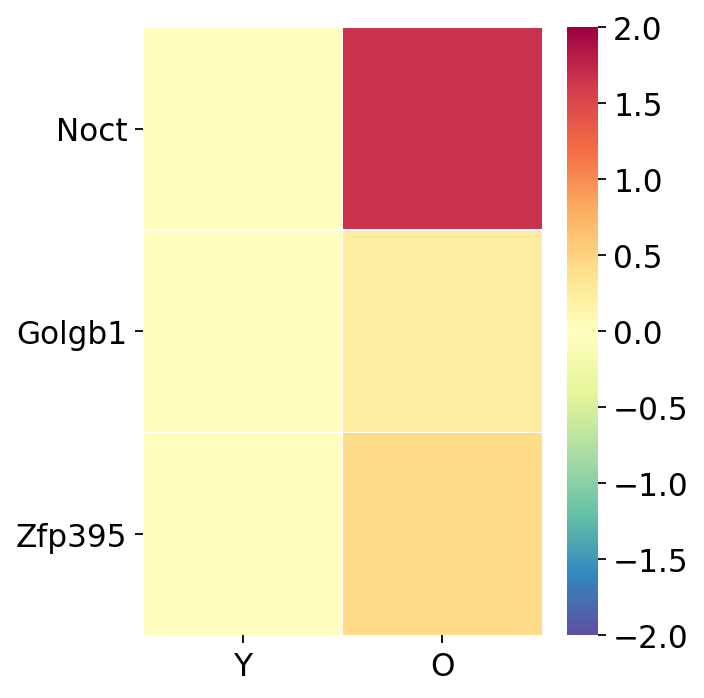

Trying to set attribute `.var` of view, copying.


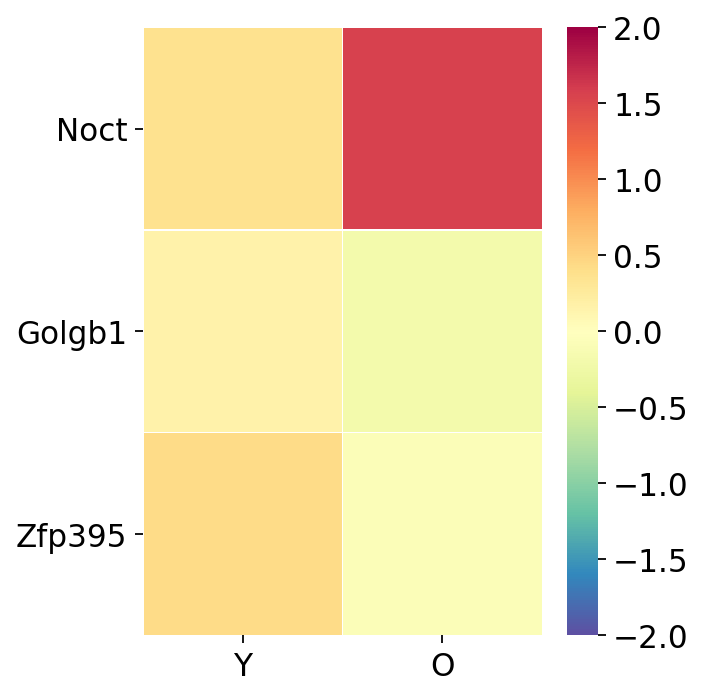

Trying to set attribute `.var` of view, copying.


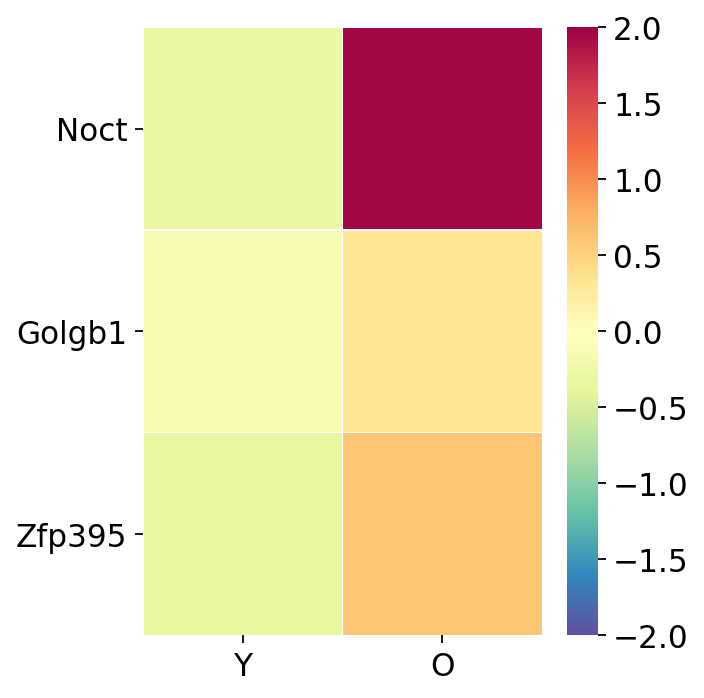

Trying to set attribute `.var` of view, copying.


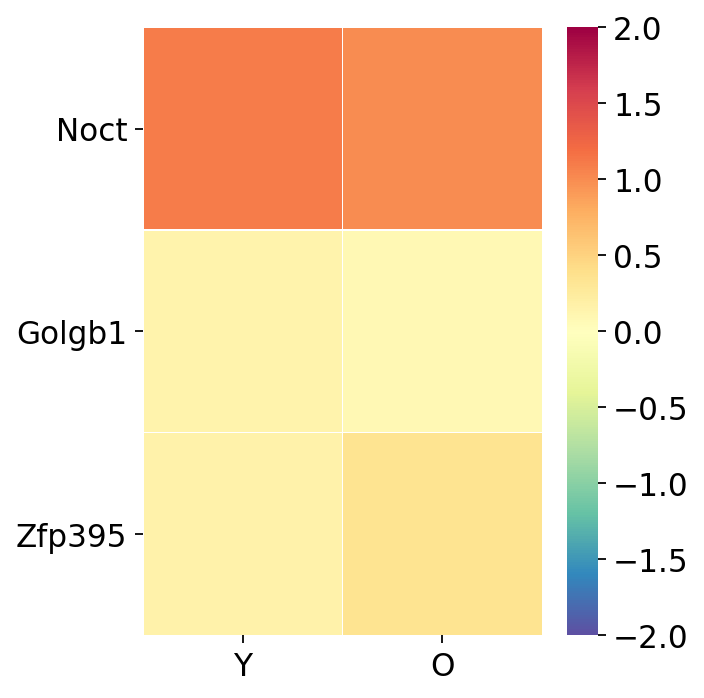

In [159]:
#fig, axs = plt.subplots(2, 2)
ages = ['young', 'old']
#plot all genes of interest as log2FC of the young WT

for idx, strain in enumerate(adata_hep.obs['strain'].cat.categories):
    #select data of interest
    adata_tmp = adata_hep[adata_hep.obs['strain']==strain].copy()
    adata_tmp = adata_tmp[:, adata_tmp.var['gene_name'].isin(gene_dict['All'])]
    #compute gene mean and logFC for each gene of interest
    for idx2, age in enumerate(ages):
        adata_tmp.var['gene_mean_' + strain + '_' + age ] = adata_tmp[adata_tmp.obs['age_grouped']==age].X.mean(axis = 0)
    if strain == 'C57Bl6/J':
        gene_mean_young_wt = adata_tmp.var['gene_mean_' + 'C57Bl6/J' + '_' + 'young']
    adata_tmp.var['log2FC_old_young'] = np.log2(adata_tmp.var['gene_mean_' + strain +'_old']) - np.log2(gene_mean_young_wt)
    adata_tmp.var['log2FC_young_young'] = np.log2(adata_tmp.var['gene_mean_' + strain + '_young']) - np.log2(gene_mean_young_wt)
    
    
    plot_data = adata_tmp.var[['gene_name','log2FC_young_young', 'log2FC_old_young']].set_index('gene_name')
    
    plt.figure(figsize = (4,5))
    sns.heatmap(plot_data, linewidths=0.2, cmap='Spectral_r', vmin = -2, vmax=2)
    plt.yticks(rotation=0)
    plt.ylabel('')
    plt.xticks([0.5, 1.5], ['Y', 'O'],rotation=0)
    plt.savefig('./figures/' + today + '_DEG_old_' + 'all-genes_'+ strain.replace('/','') + '_log2FC_YO.pdf', 
                bbox_inches='tight')
    plt.show()
   



In [78]:
strain_list = []
for idx2, strain in enumerate(table_list.keys()):
    strain_list.append(strain)

In [79]:
strain_list[1], strain_list[0] = strain_list[0], strain_list[1]

In [80]:
strain_list

['C57Bl6J', 'HNF4 KO', 'CTCF KO', 'CEBPA KO']

Trying to set attribute `.var` of view, copying.


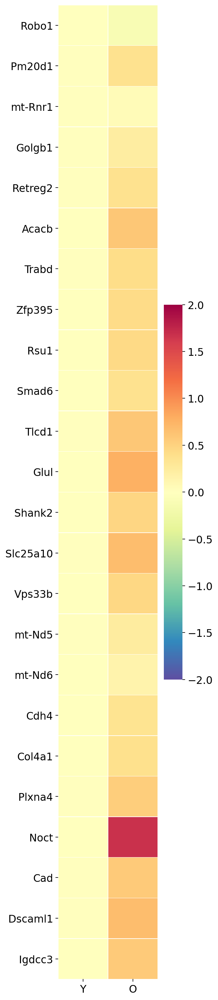

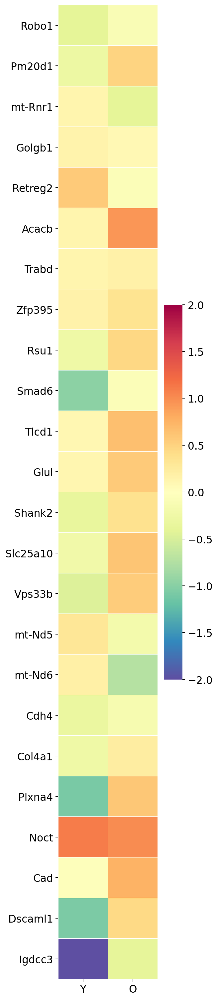

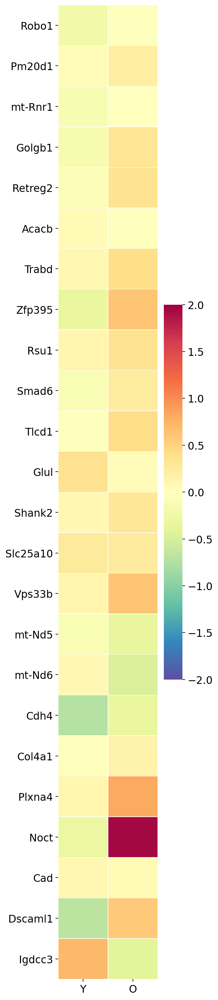

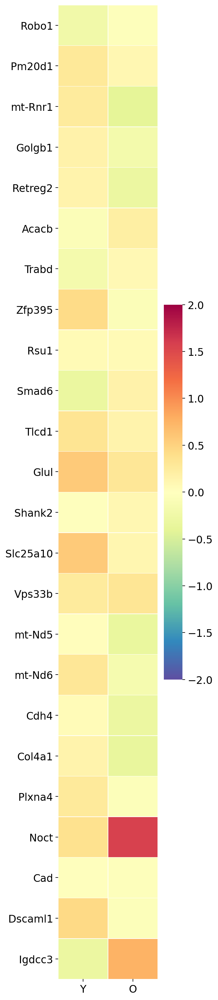

Trying to set attribute `.var` of view, copying.


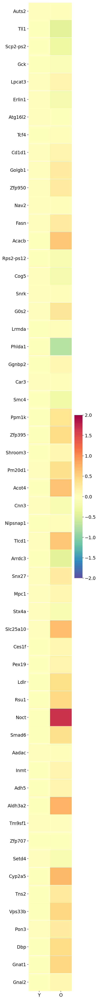

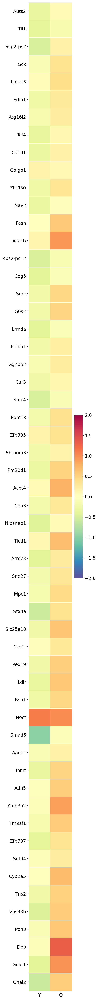

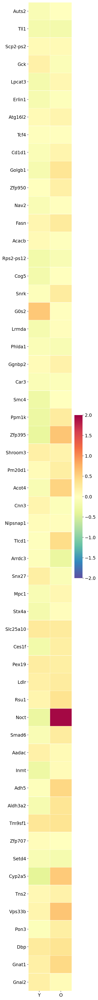

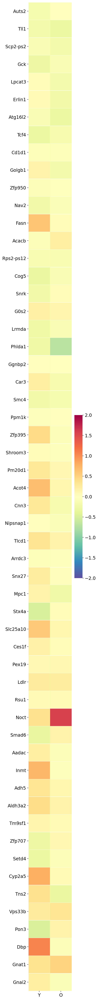

Trying to set attribute `.var` of view, copying.


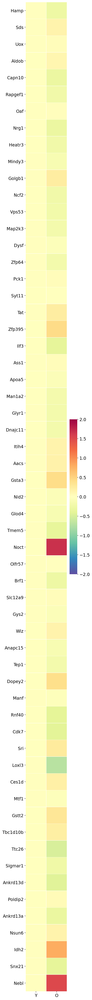

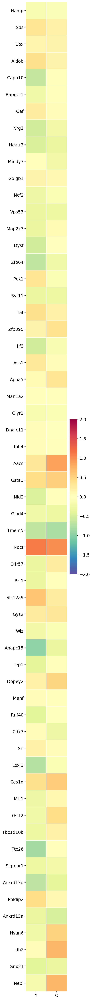

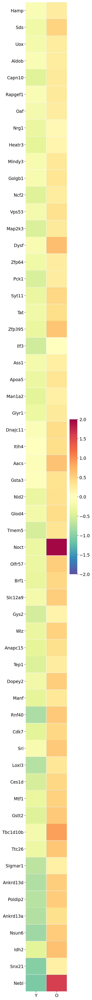

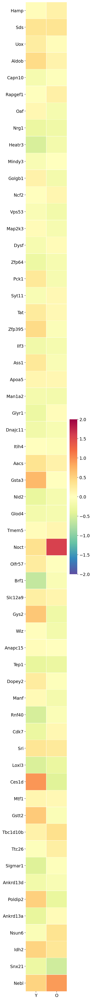

Trying to set attribute `.var` of view, copying.


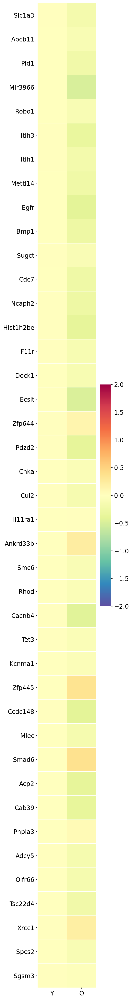

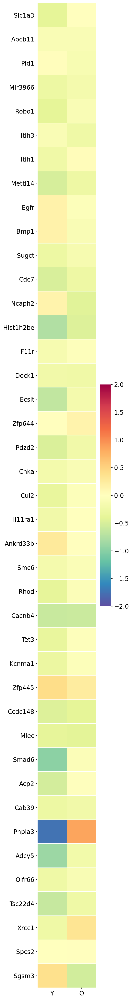

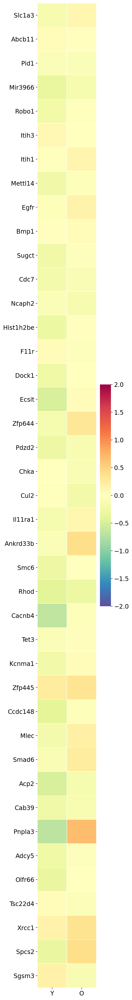

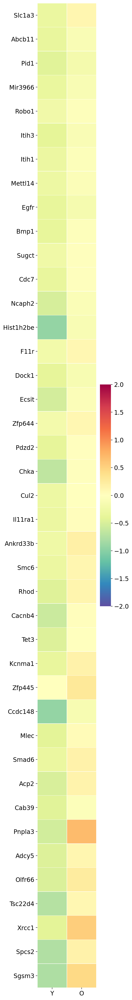

In [81]:
ages = ['young', 'old']
#plot all genes of interest as log2FC of the young WT

for idx2, strain in enumerate(strain_list):
    
    data_table = table_list[strain]
    
    if strain == 'C57Bl6J':
        strain = 'C57Bl6/J'      
    #sort genes
    genes_sorted = data_table.loc[data_table['gene_name'].isin(
        gene_dict[strain])].sort_values('young_mean', ascending=False)['gene_name']
    
    #select data of interest
    adata_tmp = adata_hep[:, adata_hep.var['gene_name'].isin(genes_sorted)]
    adata_tmp_wt_young = adata_hep[np.logical_and(adata_hep.obs['strain']=='C57Bl6/J',
                                                  adata_hep.obs['age_grouped']=='young'
                                                 )].copy()
    adata_tmp_wt_young = adata_tmp_wt_young[:, adata_tmp_wt_young.var['gene_name'].isin(genes_sorted)]
    gene_mean_young_wt = adata_tmp_wt_young.X.mean(axis=0)
    
    for idx3, strain2 in enumerate(strain_list):
        if strain2 == 'C57Bl6J':
            strain2 = 'C57Bl6/J' 
        #compute gene mean and logFC for each gene of interest
        for idx4, age in enumerate(ages):
            group_oi = np.logical_and(adata_tmp.obs['strain']==strain2,
                                      adata_tmp.obs['age_grouped']==age)
            adata_tmp.var['gene_mean_' + strain2 + '_' + age ] = adata_tmp[group_oi].X.mean(axis = 0)
            
        adata_tmp.var['log2FC_old_young'] = np.log2(adata_tmp.var['gene_mean_' + strain2 +'_old']) - np.log2(gene_mean_young_wt)
        adata_tmp.var['log2FC_young_young'] = np.log2(adata_tmp.var['gene_mean_' + strain2 + '_young']) - np.log2(gene_mean_young_wt)
 
        plot_data = adata_tmp.var[['gene_name','log2FC_young_young', 'log2FC_old_young']].set_index('gene_name')
        plot_data = plot_data.reindex(genes_sorted)
    
        plt.figure(figsize = (3,len(genes_sorted)))
        sns.heatmap(plot_data, linewidths=0.2, cmap='Spectral_r', vmin = -2, vmax=2)
        plt.yticks(rotation=0)
        plt.ylabel('')
        plt.xticks([0.5, 1.5], ['Y', 'O'],rotation=0)
        plt.savefig('./figures/' + today + '_DEG_old_'+ str(idx2) +'_' + strain2.replace('/','') + '_log2FC_YO.pdf', 
                    bbox_inches='tight')
        plt.show()
    

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  __ = ax.pcolor(_color_df, **kwds)


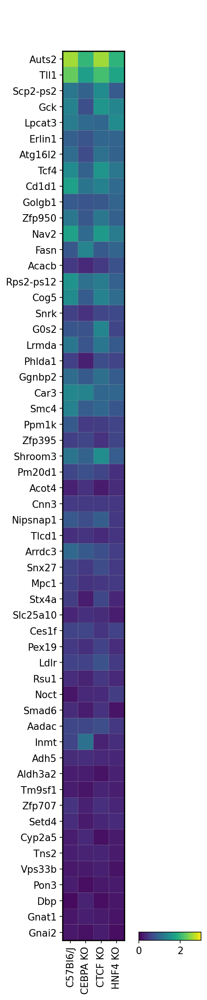

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  __ = ax.pcolor(_color_df, **kwds)


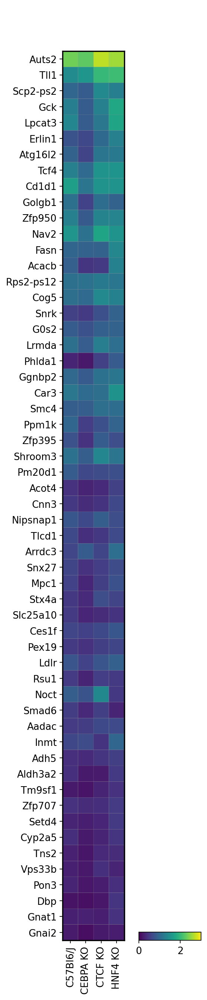

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  __ = ax.pcolor(_color_df, **kwds)


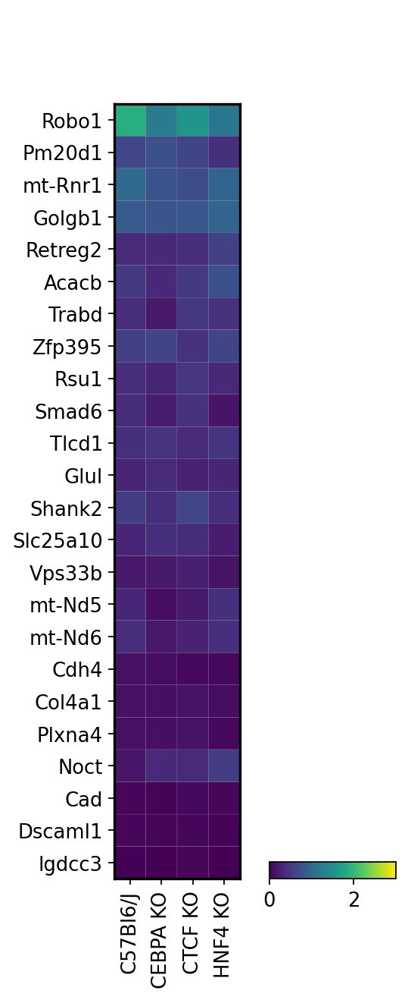

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  __ = ax.pcolor(_color_df, **kwds)


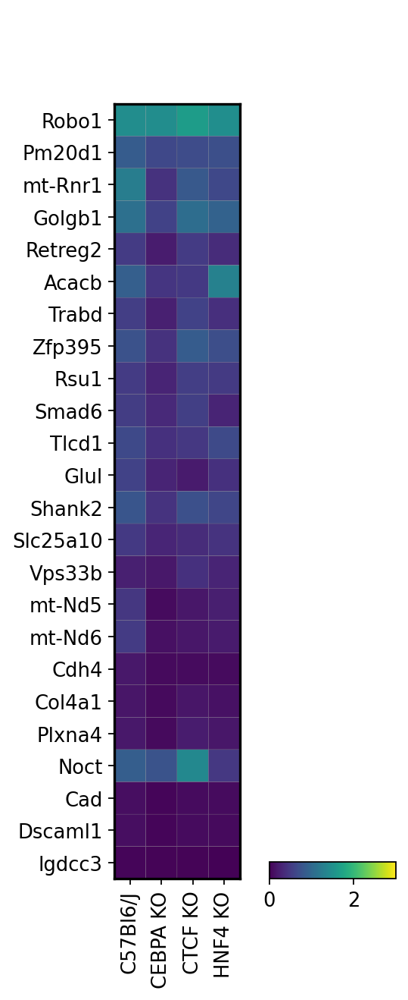

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  __ = ax.pcolor(_color_df, **kwds)


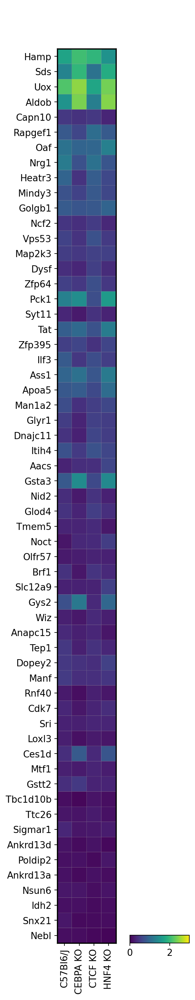

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  __ = ax.pcolor(_color_df, **kwds)


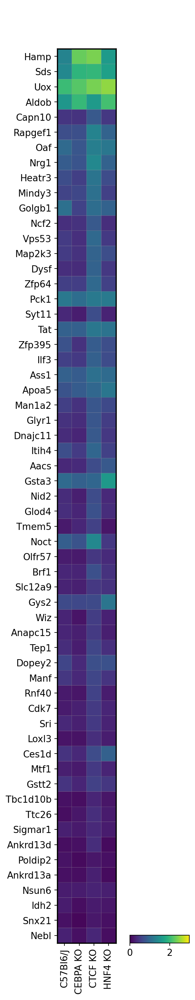

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  __ = ax.pcolor(_color_df, **kwds)


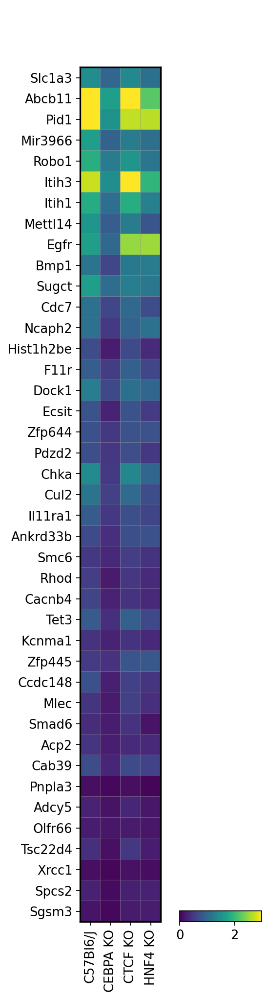

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  __ = ax.pcolor(_color_df, **kwds)


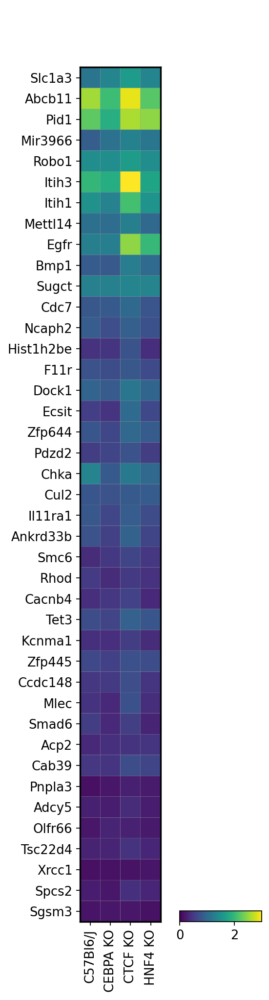

In [138]:
for idx2, strain in enumerate(table_list.keys()):
    data_table = table_list[strain]
    
    if strain == 'C57Bl6J':
        strain = 'C57Bl6/J'      
    #sort genes
    genes_sorted = data_table.loc[data_table['gene_name'].isin(
        gene_dict[strain])].sort_values('young_mean', ascending=False)['gene_name']
    
    for idx, age in enumerate(['young', 'old']):
        #plot matrixplot, one for young, one for old
        sc.pl.matrixplot(adata_hep[adata_hep.obs['age_grouped']==age].copy(),
                     groupby = 'strain',
                     var_names = genes_sorted,
                     gene_symbols = 'gene_name',
                     swap_axes = True,
                         vmax=3, vmin = 0,
                        # ax = axs[idx2+1,idx],
                     #show=False,
                         colorbar_title = '',
                     save = today + '_DEG_old_' + strain.replace('/','') + '_' + age + '.pdf'
                    )


#plt.show()

## Heatmap/matrixplots

Show genes that are upregulated in old nuclei, taking into account only by increase in nuclei count, with no separation on ploidy. Re. excel named **DEGs_old_nuclei**. Would it be possible to add on the side an indication whether if these nuclei count were increased as 2n or 4n?

In [72]:
all_tables = os.listdir(table_dir)
table_list = dict()
for table in all_tables:
    if table.count("_DE_test_young_vs_old_")>0 and table.count("_Hepatocytes_")>0:
        print(table)
        if table.startswith('2109'):
            table_tmp = pd.read_csv(table_dir + table, index_col=0)
            table_name = table.split('_')[6]
            table_list[table_name] = table_tmp

210906_DE_test_young_vs_old_HNF4 KO_Hepatocytes_gene_expression_filter25.csv
210329_DE_test_young_vs_old_C57Bl6J_Hepatocytes_gene_expression_filter25.csv
210407_DE_test_young_vs_old_HNF4 KO_Hepatocytes_gene_expression_filter25.csv
210329_DE_test_young_vs_old_CTCF KO_Hepatocytes_gene_expression_filter25.csv
210329_DE_test_young_vs_old_CEBPA KO_Hepatocytes_gene_expression_filter25.csv
210329_DE_test_young_vs_old_HNF4 KO_Hepatocytes_gene_expression_filter25.csv
210407_DE_test_young_vs_old_C57Bl6J_Hepatocytes_gene_expression_filter25.csv
210407_DE_test_young_vs_old_CEBPA KO_Hepatocytes_gene_expression_filter25.csv
210906_DE_test_young_vs_old_C57Bl6J_Hepatocytes_gene_expression_filter25.csv
210906_DE_test_young_vs_old_CTCF KO_Hepatocytes_gene_expression_filter25.csv
210906_DE_test_young_vs_old_CEBPA KO_Hepatocytes_gene_expression_filter25.csv
210407_DE_test_young_vs_old_CTCF KO_Hepatocytes_gene_expression_filter25.csv


In [77]:
old_nuc.Annotation.value_counts()

ct_nuclei       92
c_nuclei        46
h_nuclei        15
whcct_nuclei     1
Name: Annotation, dtype: int64

In [74]:
all_genes = list()
wt_genes = list()
hnf_genes = list()
cebpa_genes = list()
ctcf_genes = list()

for idx in old_nuc.index:
    #get annotation
    gene, anno = old_nuc.iloc[idx].values
    if anno.startswith('w'):
        wt_genes.append(gene)
    if anno.count('h')>0:
        hnf_genes.append(gene)    
    if anno.count('c_'):
        cebpa_genes.append(gene)
    if anno.count('ct_'):
        ctcf_genes.append(gene)
    if anno.count('whcct_'):
        all_genes.append(gene)

In [75]:
table_list.keys()

dict_keys(['HNF4 KO', 'C57Bl6J', 'CTCF KO', 'CEBPA KO'])

In [76]:
gene_dict = {'C57Bl6/J': wt_genes, 
             'HNF4 KO': hnf_genes,
             'CTCF KO': ctcf_genes,
             'CEBPA KO': cebpa_genes,
             'All': all_genes
            }

Create matrix plots sorted by mean expression per strain.

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  __ = ax.pcolor(_color_df, **kwds)


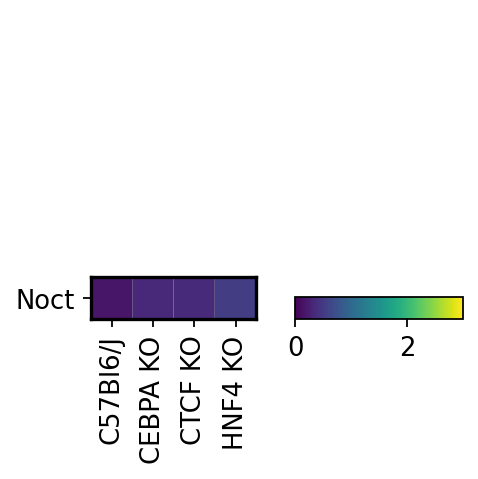

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  __ = ax.pcolor(_color_df, **kwds)


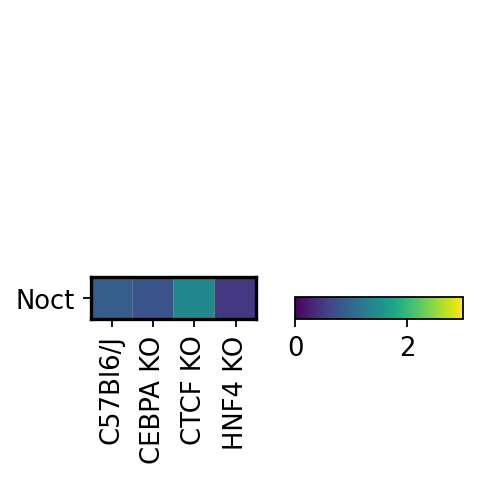

In [80]:
#fig, axs = plt.subplots(2, 2)

#plot all genes
for idx, age in enumerate(['young', 'old']):
    #plot matrixplot, one for young, one for old
    sc.pl.matrixplot(adata_hep[adata_hep.obs['age_grouped']==age].copy(),
                     groupby = 'strain',
                     var_names = gene_dict['All'],
                     gene_symbols = 'gene_name',
                     swap_axes = True,
                      vmax = 3, vmin = 0,
                     #ax = axs[0,idx],
                     #show=False, 
                      colorbar_title = '',
                     
                     save = today + '_old_nuc_' + 'all-genes' + '_' + age + '.pdf'
                    )
    



... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  __ = ax.pcolor(_color_df, **kwds)


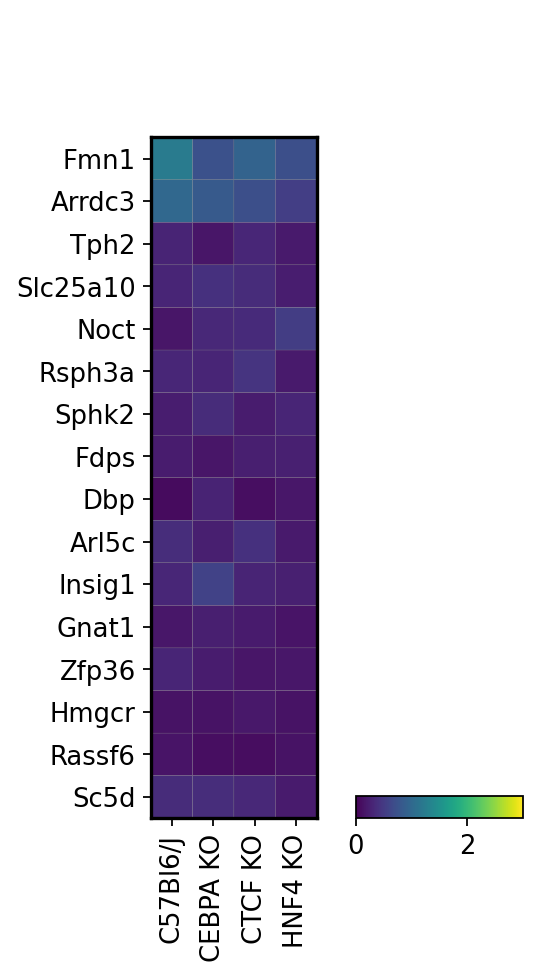

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  __ = ax.pcolor(_color_df, **kwds)


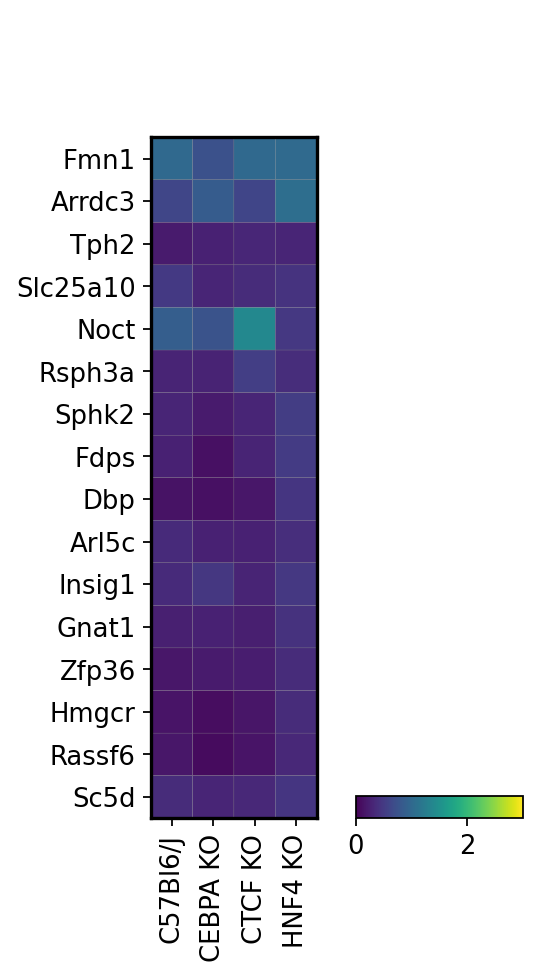

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  __ = ax.pcolor(_color_df, **kwds)


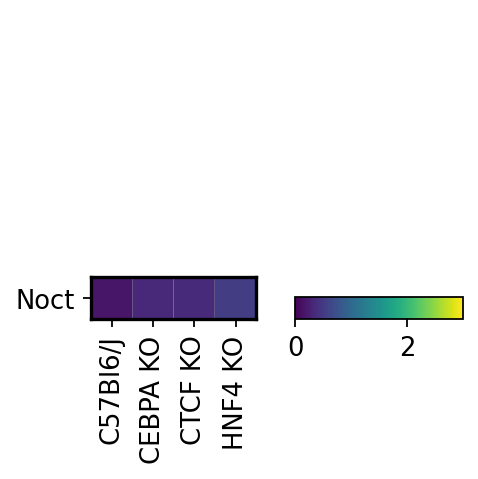

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  __ = ax.pcolor(_color_df, **kwds)


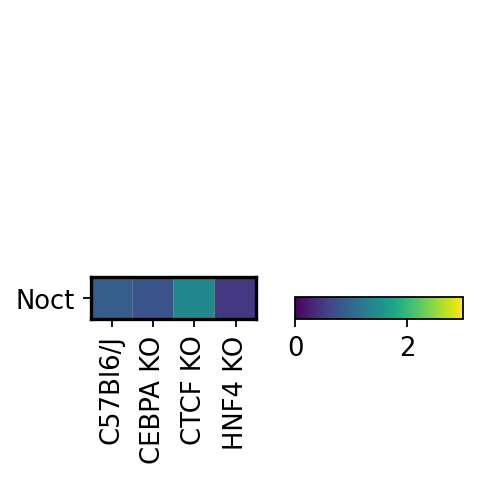

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  __ = ax.pcolor(_color_df, **kwds)


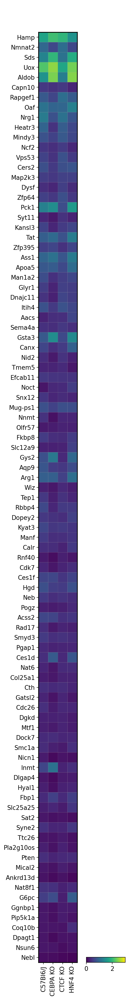

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  __ = ax.pcolor(_color_df, **kwds)


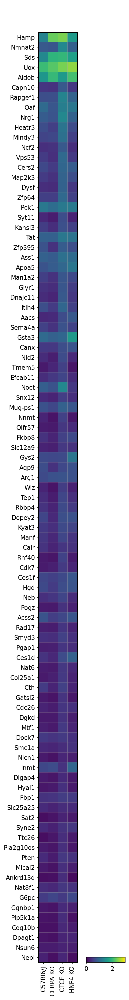

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  __ = ax.pcolor(_color_df, **kwds)


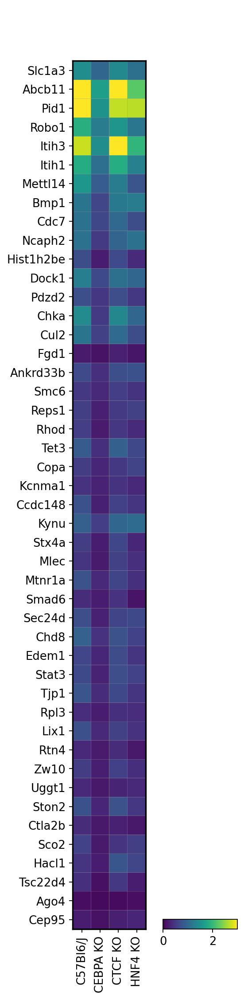

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  __ = ax.pcolor(_color_df, **kwds)


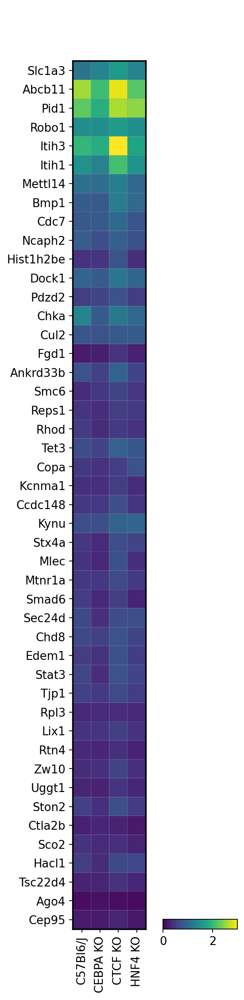

In [81]:
for idx2, strain in enumerate(table_list.keys()):
    data_table = table_list[strain]
    
    if strain == 'C57Bl6J':
        strain = 'C57Bl6/J'      
    #sort genes
    genes_sorted = data_table.loc[data_table['gene_name'].isin(
        gene_dict[strain])].sort_values('young_mean', ascending=False)['gene_name']
    
    for idx, age in enumerate(['young', 'old']):
        #plot matrixplot, one for young, one for old
        sc.pl.matrixplot(adata_hep[adata_hep.obs['age_grouped']==age].copy(),
                     groupby = 'strain',
                     var_names = genes_sorted,
                     gene_symbols = 'gene_name',
                     swap_axes = True,
                         vmax=3, vmin = 0,
                        # ax = axs[idx2+1,idx],
                     #show=False,
                         colorbar_title = '',
                     save = today + '_old_nuc_' + strain.replace('/','') + '_' + age + '.pdf'
                    )


#plt.show()

## Heatmap/matrixplot

Finally, I found that most DEGs in old mutant mice came from 4n nuclei. Therefore I went into the 4n compartment and compiled a list of genes out of the 4n DEGs you previously generated. In excel: **DEGs_4n_changes**, I annotated them as either 4n change in expression (4n_exp) or 4n change in nuclei (4n_nuclei).

In [82]:
all_tables = os.listdir(table_dir)
table_list = dict()
for table in all_tables:
    if table.count("_DE_test_young_vs_old_")>0 and table.count("_Hepatocytes_")>0:
        print(table)
        if table.startswith('2109'):
            table_tmp = pd.read_csv(table_dir + table, index_col=0)
            table_name = table.split('_')[6]
            table_list[table_name] = table_tmp

210906_DE_test_young_vs_old_HNF4 KO_Hepatocytes_gene_expression_filter25.csv
210329_DE_test_young_vs_old_C57Bl6J_Hepatocytes_gene_expression_filter25.csv
210407_DE_test_young_vs_old_HNF4 KO_Hepatocytes_gene_expression_filter25.csv
210329_DE_test_young_vs_old_CTCF KO_Hepatocytes_gene_expression_filter25.csv
210329_DE_test_young_vs_old_CEBPA KO_Hepatocytes_gene_expression_filter25.csv
210329_DE_test_young_vs_old_HNF4 KO_Hepatocytes_gene_expression_filter25.csv
210407_DE_test_young_vs_old_C57Bl6J_Hepatocytes_gene_expression_filter25.csv
210407_DE_test_young_vs_old_CEBPA KO_Hepatocytes_gene_expression_filter25.csv
210906_DE_test_young_vs_old_C57Bl6J_Hepatocytes_gene_expression_filter25.csv
210906_DE_test_young_vs_old_CTCF KO_Hepatocytes_gene_expression_filter25.csv
210906_DE_test_young_vs_old_CEBPA KO_Hepatocytes_gene_expression_filter25.csv
210407_DE_test_young_vs_old_CTCF KO_Hepatocytes_gene_expression_filter25.csv


In [83]:
DE_4n_changes.Annotation.value_counts()

c_4n_exp        41
ct_4n_exp       27
c_4n_nuclei     22
h_4n_nuclei     18
ct_4n_nuclei    16
h_4n_exp        14
w_4n_exp         7
w_4n_nuclei      6
hc_4n_exp        6
Name: Annotation, dtype: int64

In [92]:
DE_4n_changes.Annotation.unique()

array(['w_4n_exp', 'w_4n_nuclei', 'h_4n_exp', 'h_4n_nuclei', 'c_4n_exp',
       'c_4n_nuclei', 'ct_4n_exp', 'ct_4n_nuclei', 'hc_4n_exp'],
      dtype=object)

In [95]:
wt_genes_nuc = list()
hnf_genes_nuc = list()
cebpa_genes_nuc = list()
ctcf_genes_nuc = list()

wt_genes = list()
hnf_genes = list()
cebpa_genes = list()
ctcf_genes = list()

for idx in DE_4n_changes.index:
    #get annotation
    gene, anno = DE_4n_changes.iloc[idx].values
    if anno.endswith('exp'):
        if anno.startswith('w'):
            wt_genes.append(gene)
        if anno.count('h')>0:
            hnf_genes.append(gene)    
        if anno.count('c_'):
            cebpa_genes.append(gene)
        if anno.count('ct_'):
            ctcf_genes.append(gene)

    else:    
        if anno.startswith('w'):
            wt_genes_nuc.append(gene)
        if anno.count('h')>0:
            hnf_genes_nuc.append(gene)    
        if anno.count('c_'):
            cebpa_genes_nuc.append(gene)
        if anno.count('ct_'):
            ctcf_genes_nuc.append(gene)


In [96]:
table_list.keys()

dict_keys(['HNF4 KO', 'C57Bl6J', 'CTCF KO', 'CEBPA KO'])

In [97]:
gene_dict = {'C57Bl6/J': wt_genes,  
             'HNF4 KO': hnf_genes,
             'CTCF KO': ctcf_genes,
             'CEBPA KO': cebpa_genes,
            }

gene_dict_nuc = {'C57Bl6/J': wt_genes_nuc,  
             'HNF4 KO': hnf_genes_nuc,
             'CTCF KO': ctcf_genes_nuc,
             'CEBPA KO': cebpa_genes_nuc,
            }

Create matrix plots sorted by mean expression per strain.

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  __ = ax.pcolor(_color_df, **kwds)


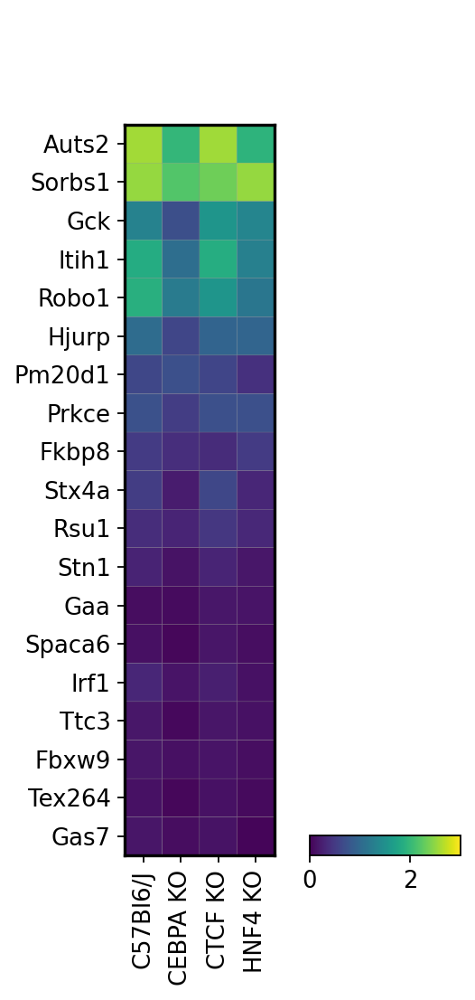

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  __ = ax.pcolor(_color_df, **kwds)


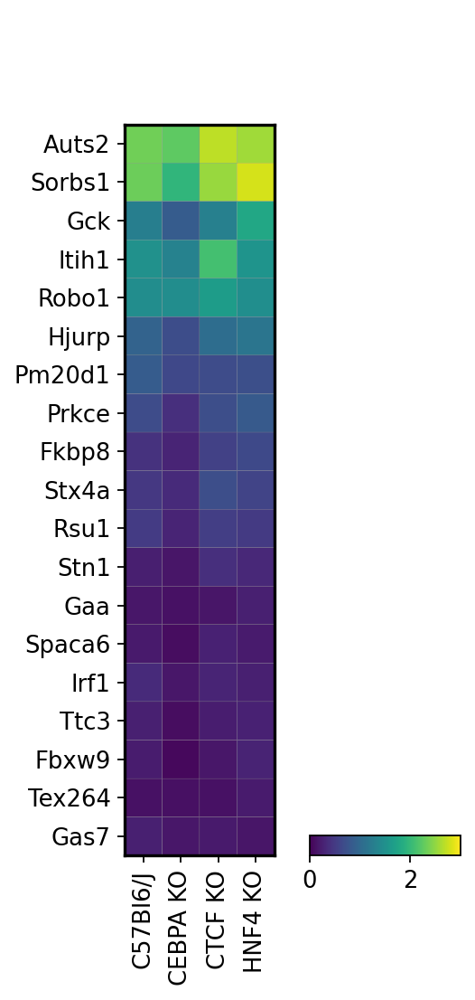

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  __ = ax.pcolor(_color_df, **kwds)


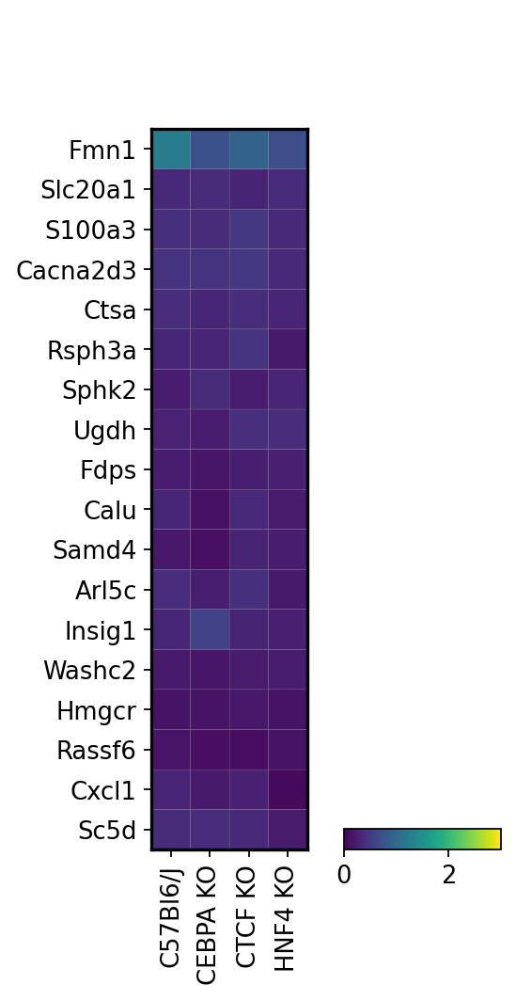

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  __ = ax.pcolor(_color_df, **kwds)


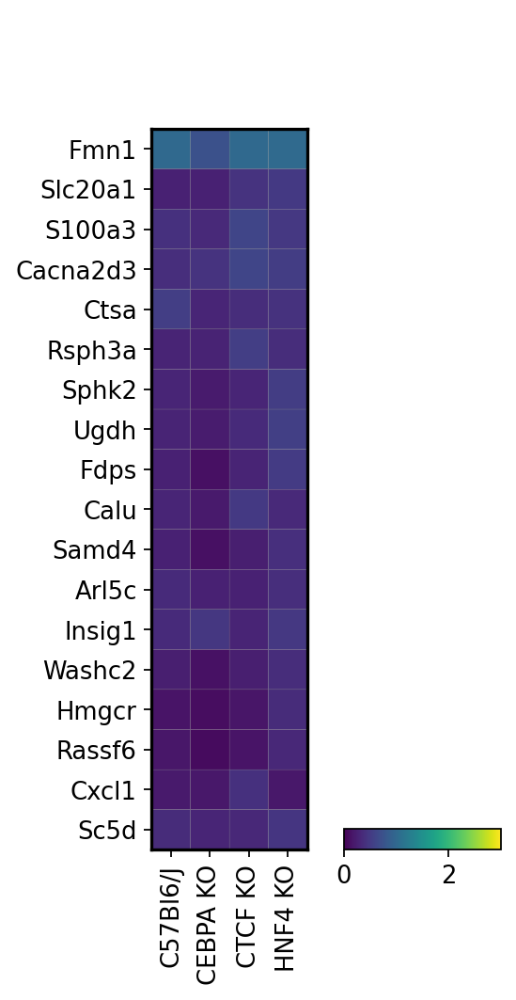

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  __ = ax.pcolor(_color_df, **kwds)


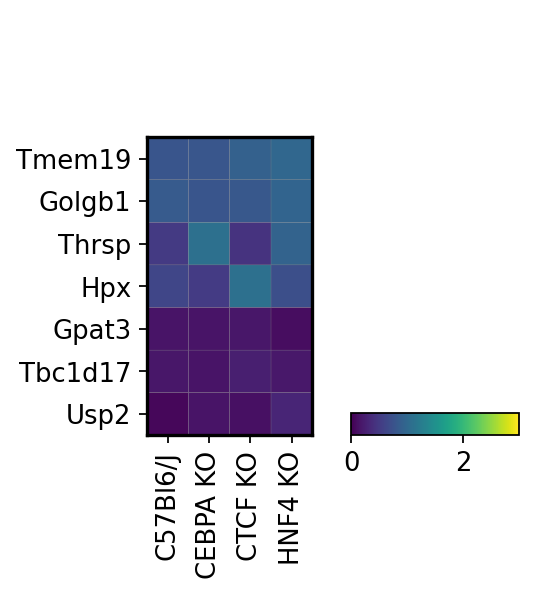

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  __ = ax.pcolor(_color_df, **kwds)


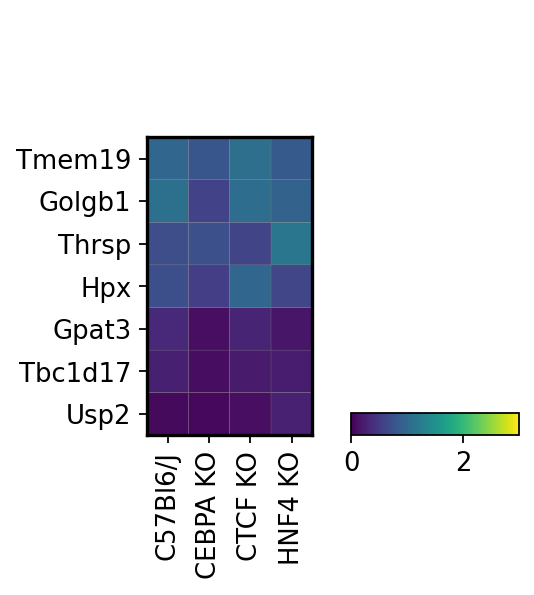

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  __ = ax.pcolor(_color_df, **kwds)


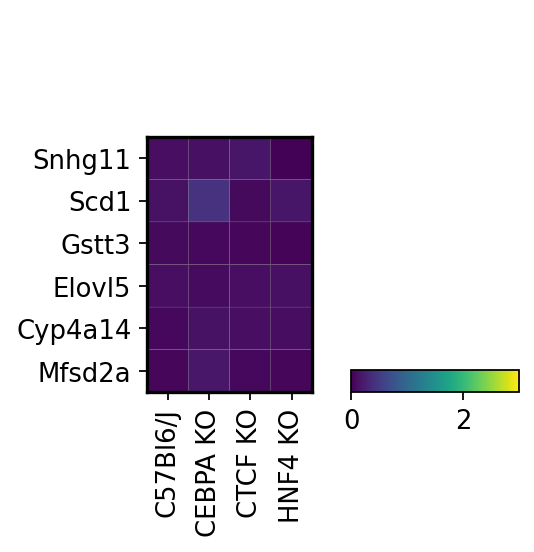

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  __ = ax.pcolor(_color_df, **kwds)


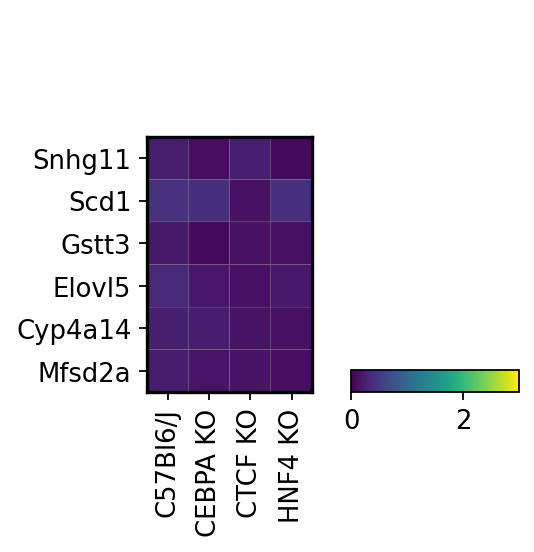

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  __ = ax.pcolor(_color_df, **kwds)


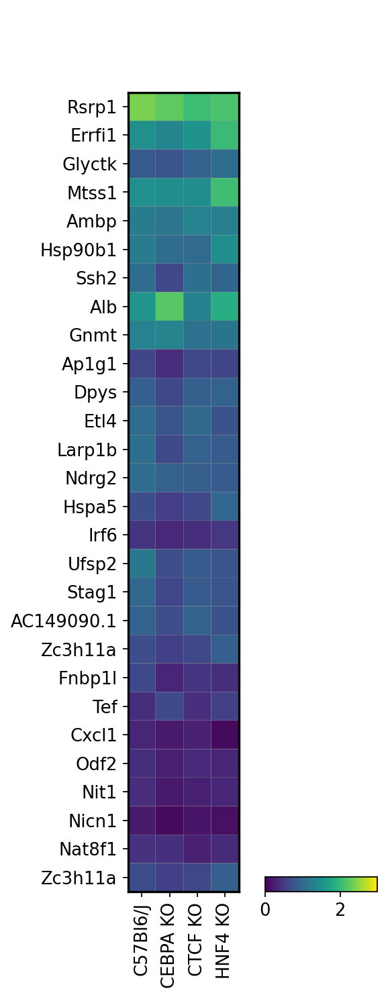

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  __ = ax.pcolor(_color_df, **kwds)


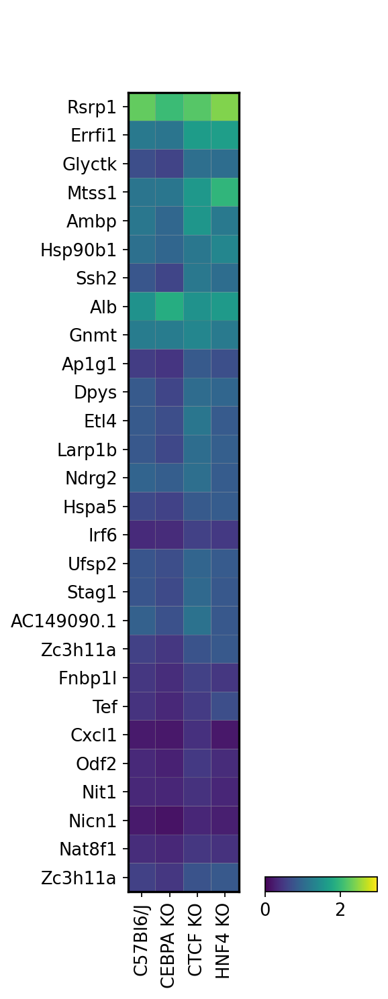

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  __ = ax.pcolor(_color_df, **kwds)


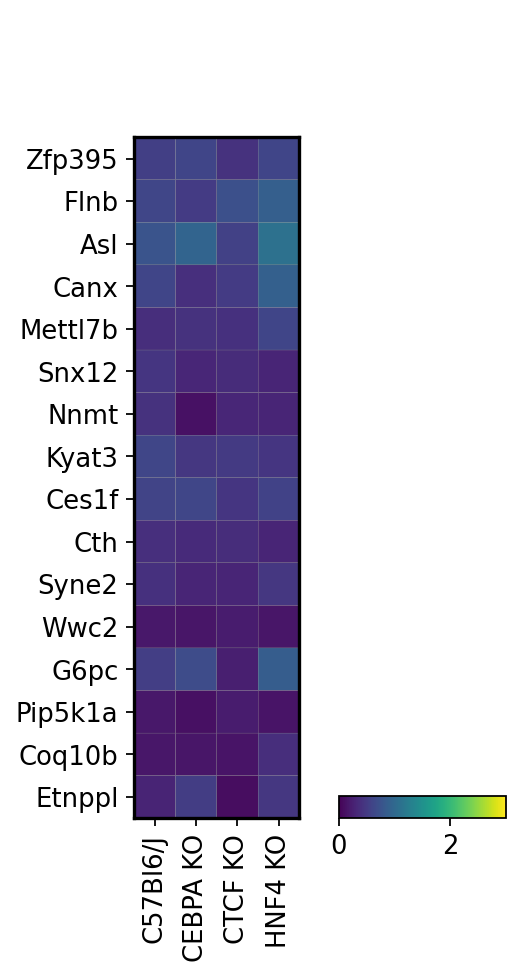

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  __ = ax.pcolor(_color_df, **kwds)


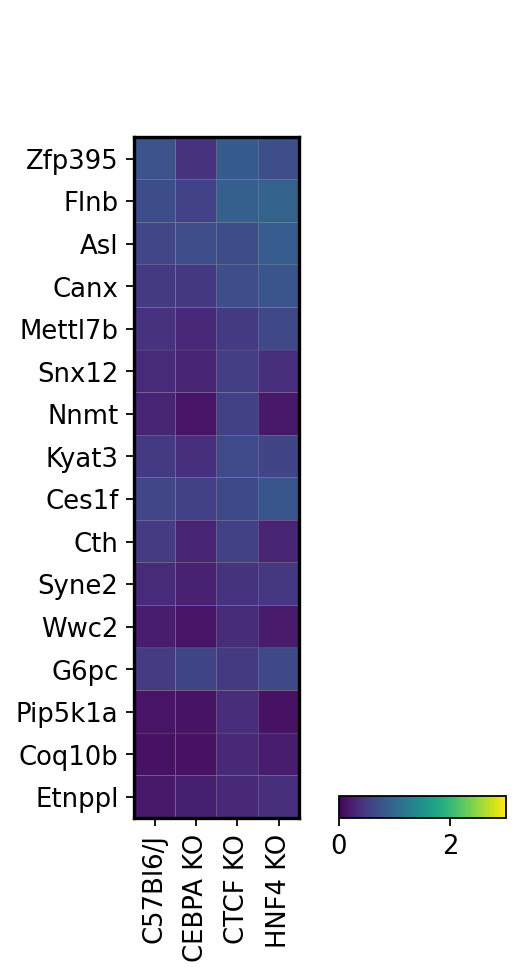

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  __ = ax.pcolor(_color_df, **kwds)


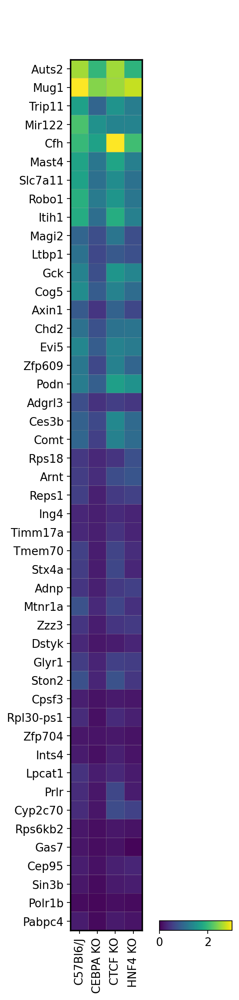

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  __ = ax.pcolor(_color_df, **kwds)


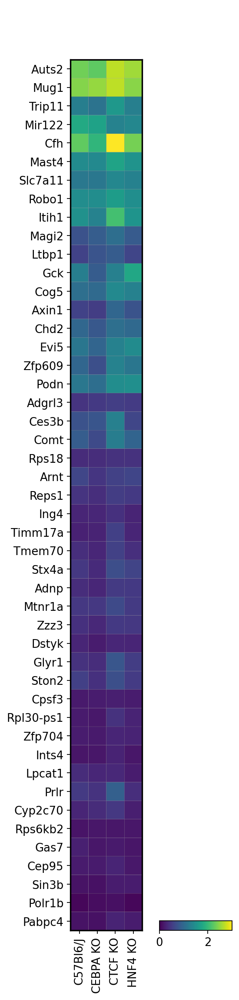

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  __ = ax.pcolor(_color_df, **kwds)


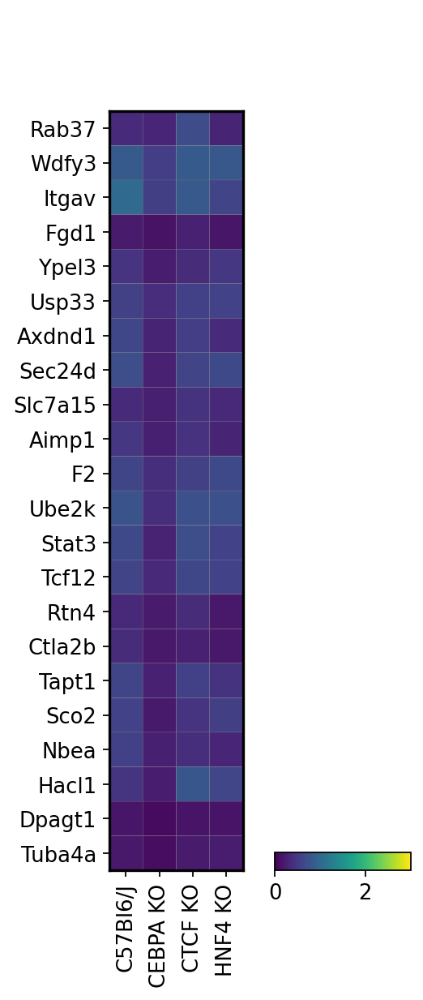

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/plotting/_matrixplot.py:222: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  __ = ax.pcolor(_color_df, **kwds)


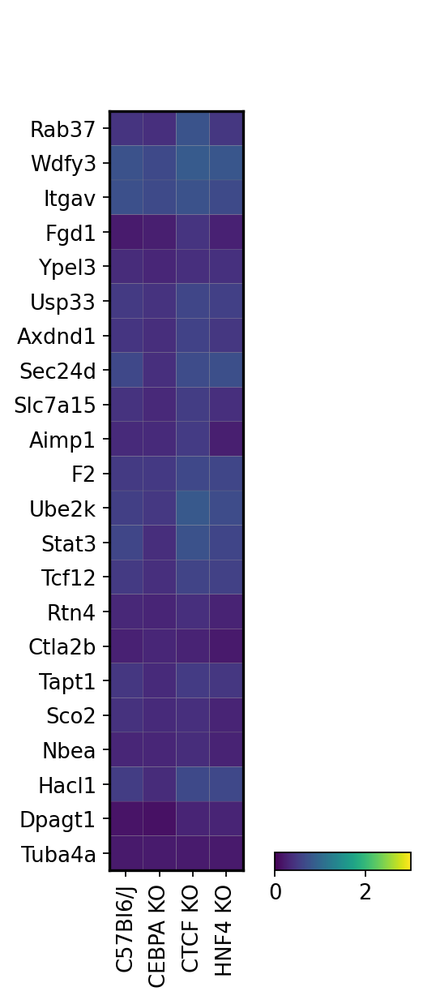

In [99]:
for idx2, strain in enumerate(table_list.keys()):
    data_table = table_list[strain]
    
    if strain == 'C57Bl6J':
        strain = 'C57Bl6/J'      
    #sort genes
    genes_sorted = data_table.loc[data_table['gene_name'].isin(
        gene_dict[strain])].sort_values('young_mean', ascending=False)['gene_name']
    
    for idx, age in enumerate(['young', 'old']):
        #plot matrixplot, one for young, one for old
        sc.pl.matrixplot(adata_hep[adata_hep.obs['age_grouped']==age].copy(),
                     groupby = 'strain',
                     var_names = genes_sorted,
                     gene_symbols = 'gene_name',
                     swap_axes = True,
                         vmax=3, vmin = 0,
                        # ax = axs[idx2+1,idx],
                     #show=False,
                         colorbar_title = '',
                     save = today + '_DE_4n_changes_exp_' + strain.replace('/','') + '_' + age + '.pdf'
                    )
    
    #sort genes
    genes_sorted = data_table.loc[data_table['gene_name'].isin(
        gene_dict_nuc[strain])].sort_values('young_mean', ascending=False)['gene_name']
    
    for idx, age in enumerate(['young', 'old']):
        #plot matrixplot, one for young, one for old
        sc.pl.matrixplot(adata_hep[adata_hep.obs['age_grouped']==age].copy(),
                     groupby = 'strain',
                     var_names = genes_sorted,
                     gene_symbols = 'gene_name',
                     swap_axes = True,
                         vmax=3, vmin = 0,
                        # ax = axs[idx2+1,idx],
                     #show=False,
                         colorbar_title = '',
                     save = today + '_DE_4n_changes_nuc_' + strain.replace('/','') + '_' + age + '.pdf'
                    )


#plt.show()

# Dotplots and violin plots

Genes from hepatocytes of all 4 strains, separating them based on young 2n and 4n, as well as old 2n and 4n.

In [68]:
tfs_sharing_dict.keys()

dict_keys(['shared with cebpa', 'shared with ctcf', 'shared with hnf4a'])

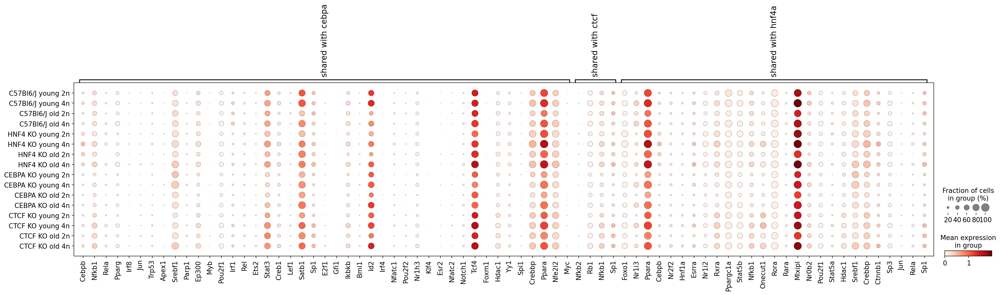

In [80]:
sc.pl.dotplot(adata_hep, #figsize=(10,7),
              gene_symbols='gene_name', 
              groupby='strain_age_ploidy', #swap_axes=True, 
              var_names = tfs_sharing_dict,#['shared with cebpa'], #cmap='YlGnBu',
              #show_gene_labels=True, standard_scale='var',
              save = today + '_tfs_shared_strains_age_ploidy.pdf'
             )

In [40]:
sc.pl.stacked_violin(adata_hep, #figsize=(10,7),
              gene_symbols='gene_name', 
              groupby='strain_age_ploidy', #swap_axes=True, 
              var_names = tfs_sharing_dict,#['shared with cebpa'], #cmap='YlGnBu',
              #show_gene_labels=True, standard_scale='var',
              save = today + '_tfs_shared_strains_age_ploidy.pdf'
             )

NameError: name 'tfs_sharing_dict' is not defined

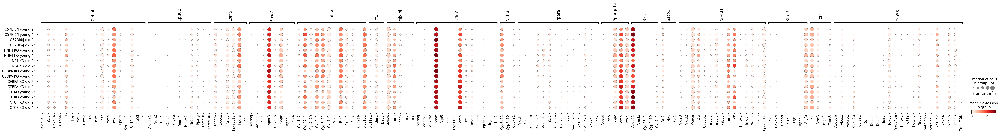

In [38]:
sc.pl.dotplot(adata_hep, #figsize=(10,7),
              gene_symbols='gene_name', 
              groupby='strain_age_ploidy', #swap_axes=True, 
              var_names = tfs_sharing_filt_dict,#['shared with cebpa'], #cmap='YlGnBu',
              #show_gene_labels=True, standard_scale='var',
              save = today + '_tfs_filt_strains_age_ploidy.pdf'
             )

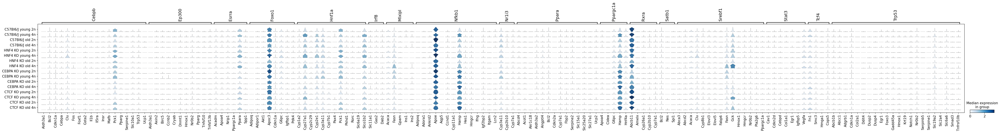

In [41]:
sc.pl.stacked_violin(adata_hep, #figsize=(10,7),
              gene_symbols='gene_name', 
              groupby='strain_age_ploidy', #swap_axes=True, 
              var_names = tfs_sharing_filt_dict,#['shared with cebpa'], #cmap='YlGnBu',
              #show_gene_labels=True, standard_scale='var',
              save = today + '_tfs_filt_strains_age_ploidy.pdf'
             )

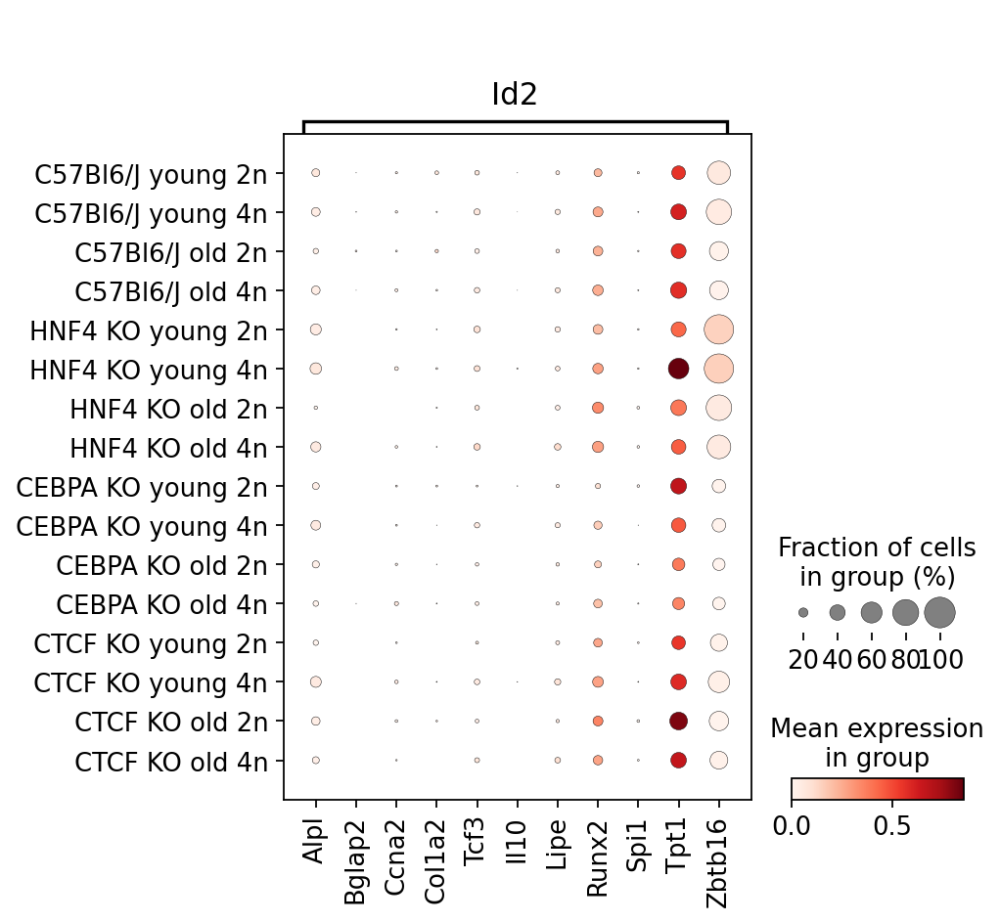

In [42]:
sc.pl.dotplot(adata_hep, #figsize=(10,7),
              gene_symbols='gene_name', 
              groupby='strain_age_ploidy', #swap_axes=True, 
              var_names = tfs_sharing_filt2_dict,#['shared with cebpa'], #cmap='YlGnBu',
              #show_gene_labels=True, standard_scale='var',
              save = today + '_tfs_filt2_strains_age_ploidy.pdf'
             )

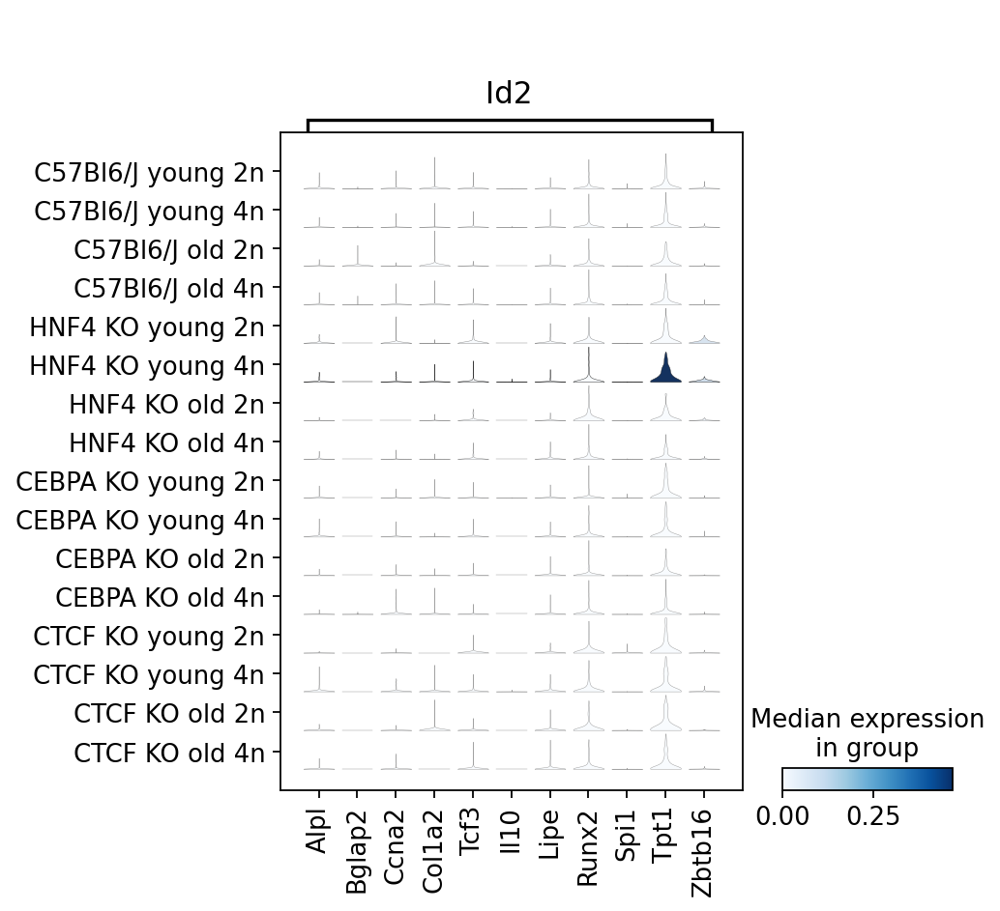

In [43]:
sc.pl.stacked_violin(adata_hep, #figsize=(10,7),
              gene_symbols='gene_name', 
              groupby='strain_age_ploidy', #swap_axes=True, 
              var_names = tfs_sharing_filt2_dict,#['shared with cebpa'], #cmap='YlGnBu',
              #show_gene_labels=True, standard_scale='var',
              save = today + '_tfs_filt2_strains_age_ploidy.pdf'
             )

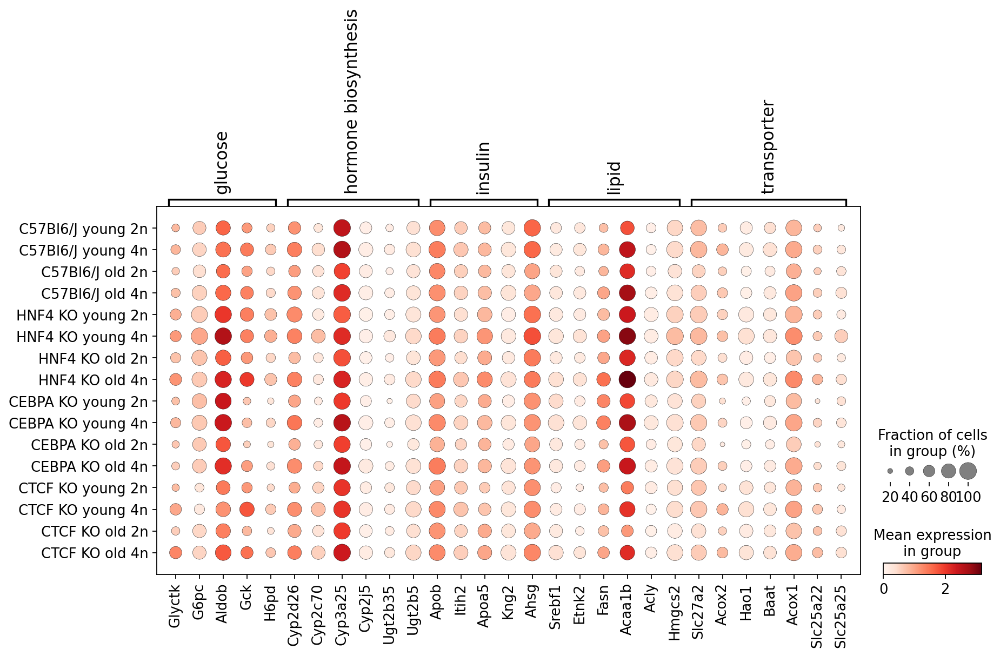

In [84]:
sc.pl.dotplot(adata_hep, #figsize=(10,7),
              gene_symbols='gene_name', 
              groupby='strain_age_ploidy', #swap_axes=True, 
              var_names = unchanged_age_dict, vmin=0,
              #show_gene_labels=True, standard_scale='var',
              save = today + '_unchanged_age_strains_age_ploidy.pdf'
             )

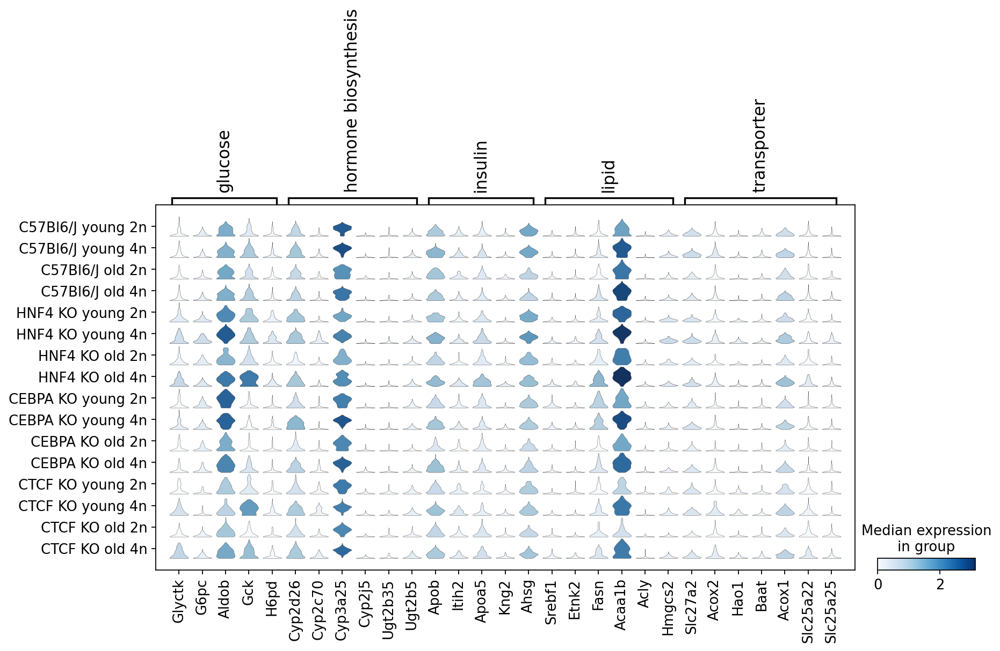

In [82]:
sc.pl.stacked_violin(adata_hep, #figsize=(10,7),
              gene_symbols='gene_name', 
              groupby='strain_age_ploidy', #swap_axes=True, 
              var_names = unchanged_age_dict,#['shared with cebpa'], #cmap='YlGnBu',
              #show_gene_labels=True, standard_scale='var',
              save = today + '_unchanged_age_strains_age_ploidy.pdf'
             )

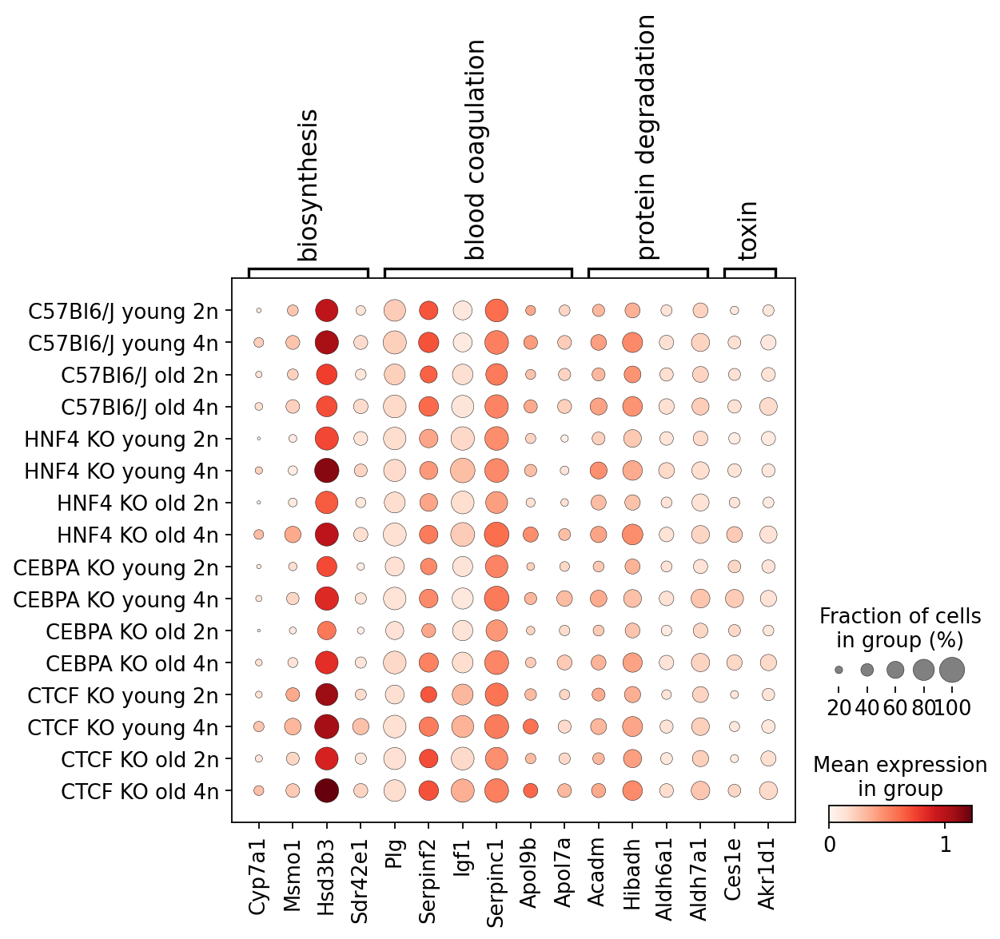

In [85]:
sc.pl.dotplot(adata_hep, #figsize=(10,7),
              gene_symbols='gene_name', 
              groupby='strain_age_ploidy', #swap_axes=True, 
              var_names = unspec_liver_dict, vmin=0,
              #show_gene_labels=True, standard_scale='var',
              save = today + '_unspec_liver_strains_age_ploidy.pdf'
             )

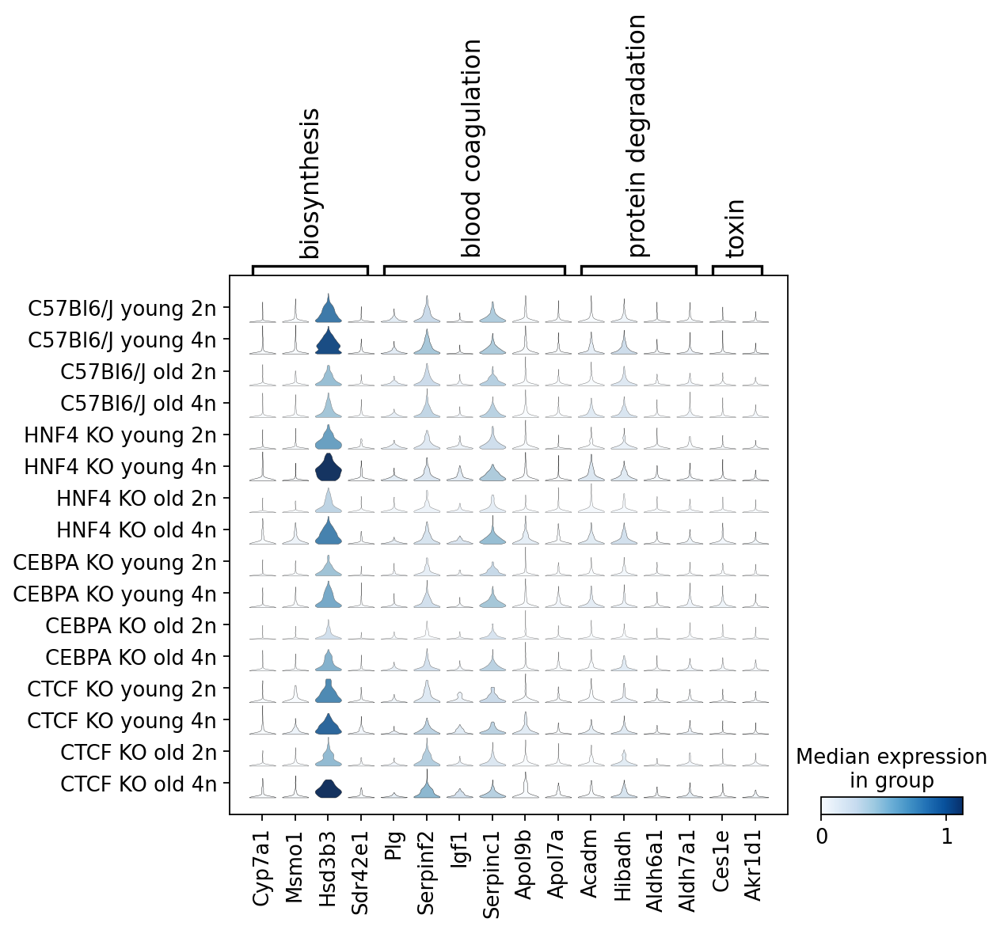

In [86]:
sc.pl.stacked_violin(adata_hep, #figsize=(10,7),
              gene_symbols='gene_name', 
              groupby='strain_age_ploidy', #swap_axes=True, 
              var_names = unspec_liver_dict,#['shared with cebpa'], #cmap='YlGnBu',
              #show_gene_labels=True, standard_scale='var',
              save = today + '_unspec_liver_strains_age_ploidy.pdf'
             )

Plot genes upregulated in 4n/all old across KO.

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


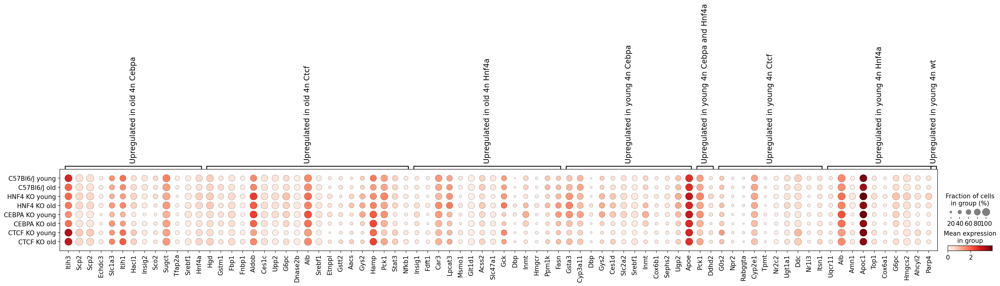

In [87]:
sc.pl.dotplot(adata_hep, #figsize=(10,7),
              gene_symbols='gene_name', 
              groupby='strain_age', #swap_axes=True, 
              var_names = up_4n_hemi_dict, vmin=0,
              #show_gene_labels=True, standard_scale='var',
              save = today + '_up_4n_hemi_KO_strains_age.pdf'
             )

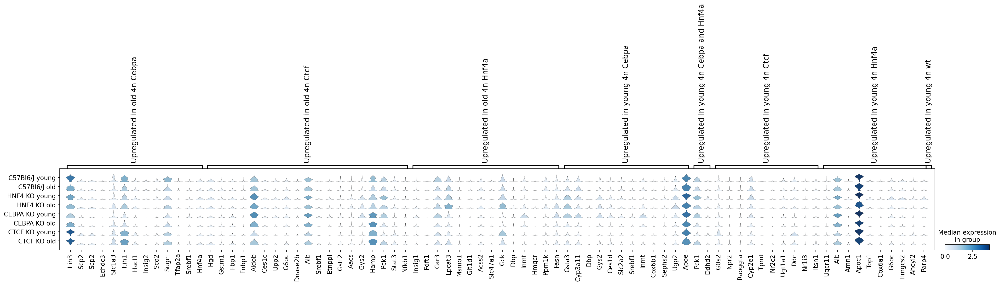

In [88]:
sc.pl.stacked_violin(adata_hep, #figsize=(10,7),
              gene_symbols='gene_name', 
              groupby='strain_age', #swap_axes=True, 
              var_names = up_4n_hemi_dict,#['shared with cebpa'], #cmap='YlGnBu',
              #show_gene_labels=True, standard_scale='var',
              save = today + '_up_4n_hemi_KO_strains_age.pdf'
             )

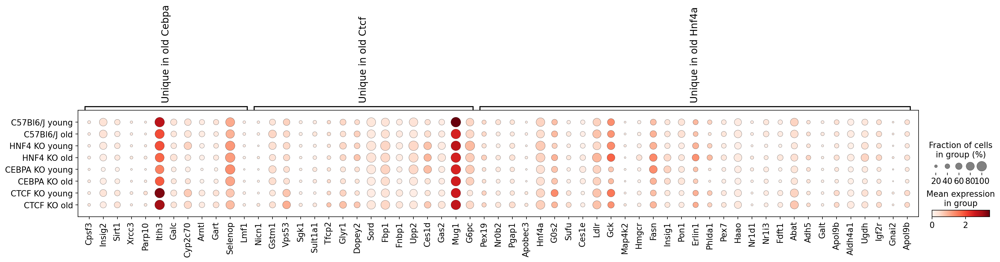

In [89]:
sc.pl.dotplot(adata_hep, #figsize=(10,7),
              gene_symbols='gene_name', 
              groupby='strain_age', #swap_axes=True, 
              var_names = up_hemi_dict, vmin=0,
              #show_gene_labels=True, standard_scale='var',
              save = today + '_up_hemi_KO_strains_age.pdf'
             )

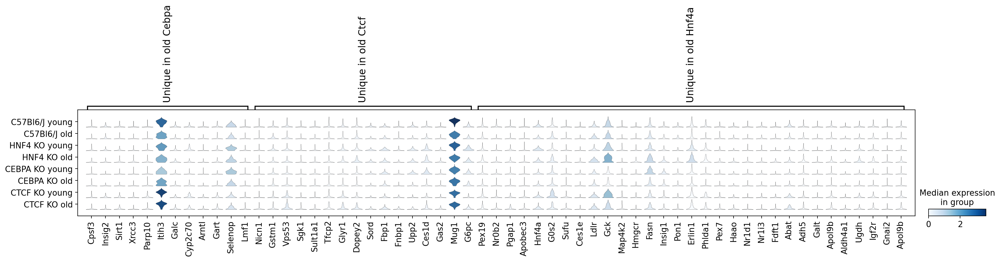

In [90]:
sc.pl.stacked_violin(adata_hep, #figsize=(10,7),
              gene_symbols='gene_name', 
              groupby='strain_age', #swap_axes=True, 
              var_names = up_hemi_dict,#['shared with cebpa'], #cmap='YlGnBu',
              #show_gene_labels=True, standard_scale='var',
              save = today + '_up_hemi_KO_strains_age.pdf'
             )

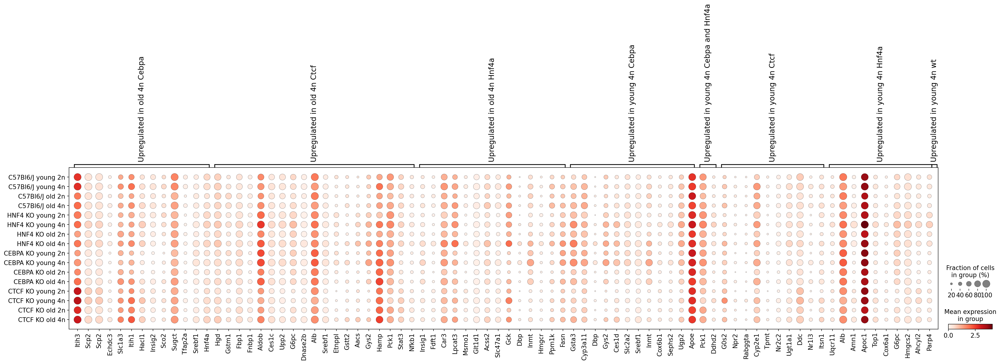

In [91]:
sc.pl.dotplot(adata_hep, #figsize=(10,7),
              gene_symbols='gene_name', 
              groupby='strain_age_ploidy', #swap_axes=True, 
              var_names = up_4n_hemi_dict, vmin=0,
              #show_gene_labels=True, standard_scale='var',
              save = today + '_up_4n_hemi_KO_strains_age_ploidy.pdf'
             )

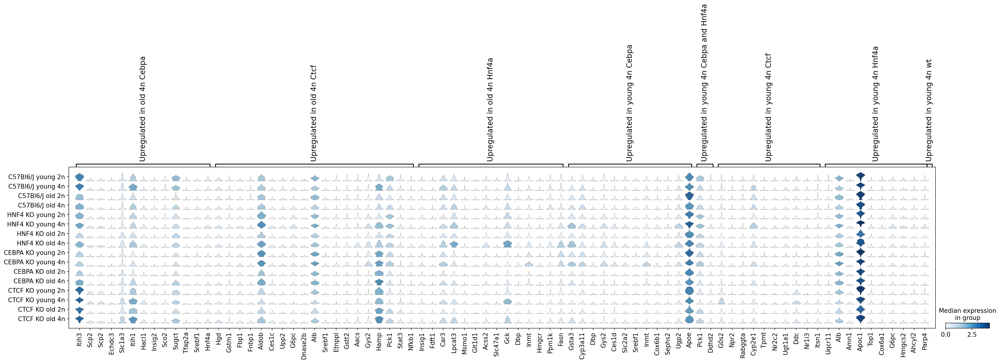

In [92]:
sc.pl.stacked_violin(adata_hep, #figsize=(10,7),
              gene_symbols='gene_name', 
              groupby='strain_age_ploidy', #swap_axes=True, 
              var_names = up_4n_hemi_dict,#['shared with cebpa'], #cmap='YlGnBu',
              #show_gene_labels=True, standard_scale='var',
              save = today + '_up_4n_hemi_KO_strains_age_ploidy.pdf'
             )

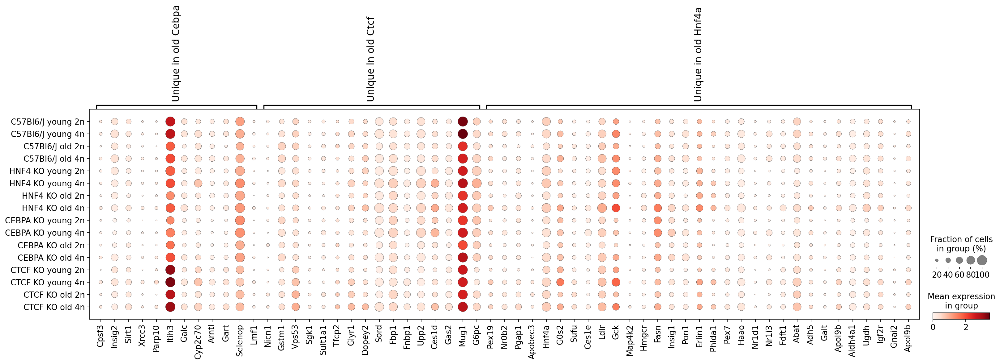

In [93]:
sc.pl.dotplot(adata_hep, #figsize=(10,7),
              gene_symbols='gene_name', 
              groupby='strain_age_ploidy', #swap_axes=True, 
              var_names = up_hemi_dict, vmin=0,
              #show_gene_labels=True, standard_scale='var',
              save = today + '_up_hemi_KO_strains_age_ploidy.pdf'
             )

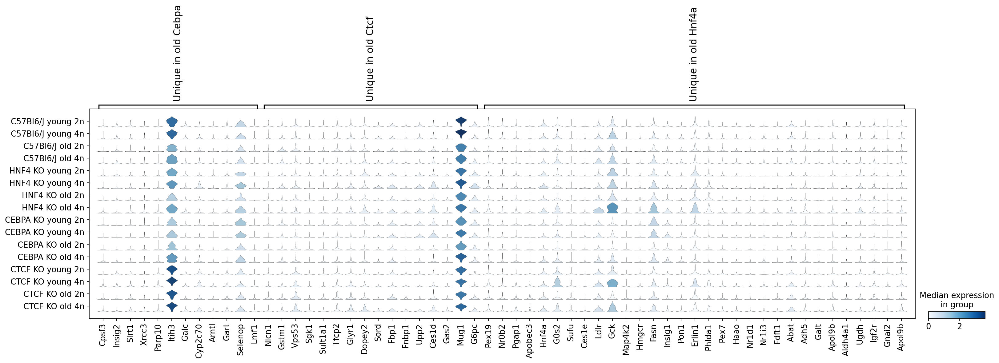

In [94]:
sc.pl.stacked_violin(adata_hep, #figsize=(10,7),
              gene_symbols='gene_name', 
              groupby='strain_age_ploidy', #swap_axes=True, 
              var_names = up_hemi_dict,#['shared with cebpa'], #cmap='YlGnBu',
              #show_gene_labels=True, standard_scale='var',
              save = today + '_up_hemi_KO_strains_age_ploidy.pdf'
             )

# Dotplots

Dotplot of these genes from hepatocytes of all 4 strains, separating them based on young and old. Regardless of ploidy. 

In [ ]:
sc.pl.dotplot(adata_hep, #figsize=(10,7),
              gene_symbols='gene_name', 
              groupby='strain_age', #swap_axes=True, 
              var_names = old_hep_dict, vmin=0,
              #show_gene_labels=True, standard_scale='var',
              save = today + '_old_hep_anno1_strains_age.pdf'
             )

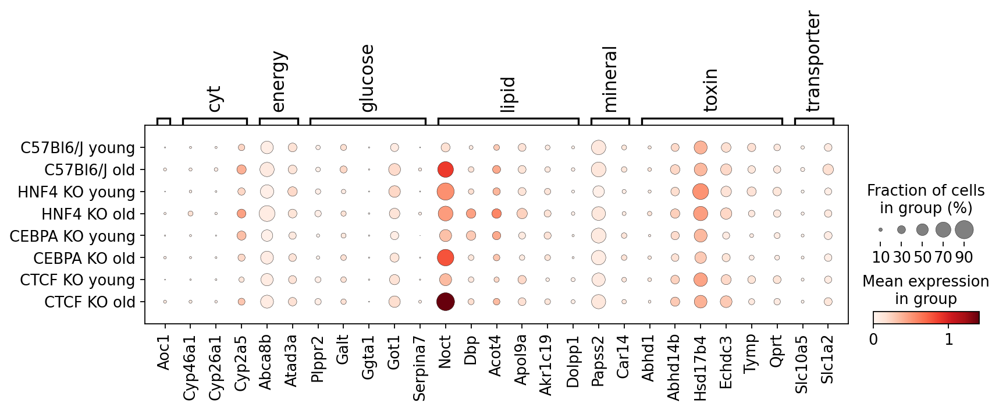

In [108]:
sc.pl.dotplot(adata_hep, #figsize=(10,7),
              gene_symbols='gene_name', 
              groupby='strain_age', #swap_axes=True, 
              var_names = old_hep_dict2, vmin=0,
              #show_gene_labels=True, standard_scale='var',
              save = today + '_old_hep_anno2_strains_age.pdf'
             )

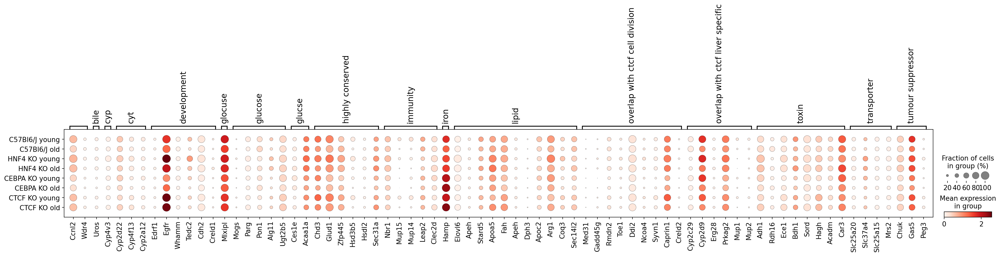

In [109]:
sc.pl.dotplot(adata_hep, #figsize=(10,7),
              gene_symbols='gene_name', 
              groupby='strain_age', #swap_axes=True, 
              var_names = young_hep_dict, vmin=0,
              #show_gene_labels=True, standard_scale='var',
              save = today + '_young_hep_strains_age.pdf'
             )

### Ageing genes (increase and decrease)

In [183]:
subset = age_increase['Genes'].values[np.in1d(age_increase['Genes'].values, adata_hep.var['gene_name'])]

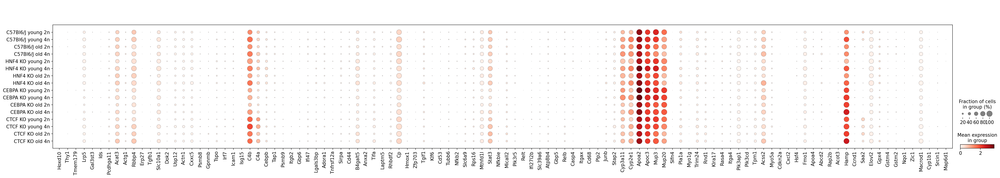

In [173]:
sc.pl.dotplot(adata_hep, #figsize=(10,7),
              gene_symbols='gene_name', 
              groupby='strain_age_ploidy', #swap_axes=True, 
              var_names = subset, vmin=0,
              #show_gene_labels=True, standard_scale='var',
              save = today + '_increase_age_strains_age_ploidy.pdf'
             )

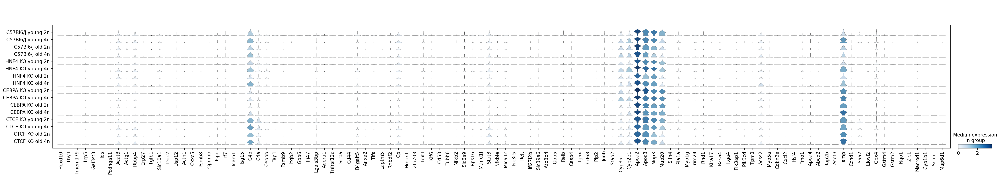

In [177]:
sc.pl.stacked_violin(adata_hep, #figsize=(10,7),
              gene_symbols='gene_name', 
              groupby='strain_age_ploidy', #swap_axes=True, 
              var_names = subset, vmin=0,
              #show_gene_labels=True, standard_scale='var',
              save = today + '_increase_age_strains_age_ploidy.pdf'
             )

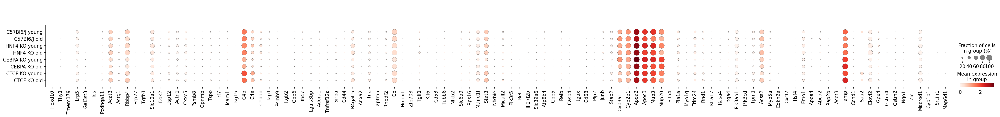

In [184]:
sc.pl.dotplot(adata_hep, #figsize=(10,7),
              gene_symbols='gene_name', 
              groupby='strain_age', #swap_axes=True, 
              var_names = subset, vmin=0,
              #show_gene_labels=True, standard_scale='var',
              save = today + '_increase_age_strains_age.pdf'
             )

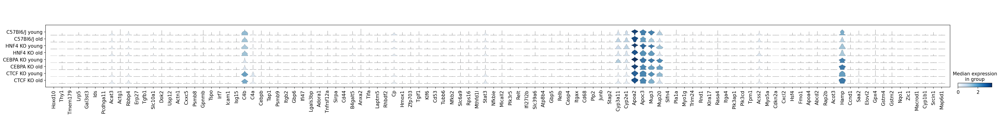

In [185]:
sc.pl.stacked_violin(adata_hep, #figsize=(10,7),
              gene_symbols='gene_name', 
              groupby='strain_age', #swap_axes=True, 
              var_names = subset, vmin=0,
              #show_gene_labels=True, standard_scale='var',
              save = today + '_increase_age_strains_age.pdf'
             )

In [179]:
subset = age_decrease['Decrease'].values[np.in1d(age_decrease['Decrease'].values, adata_hep.var['gene_name'])]

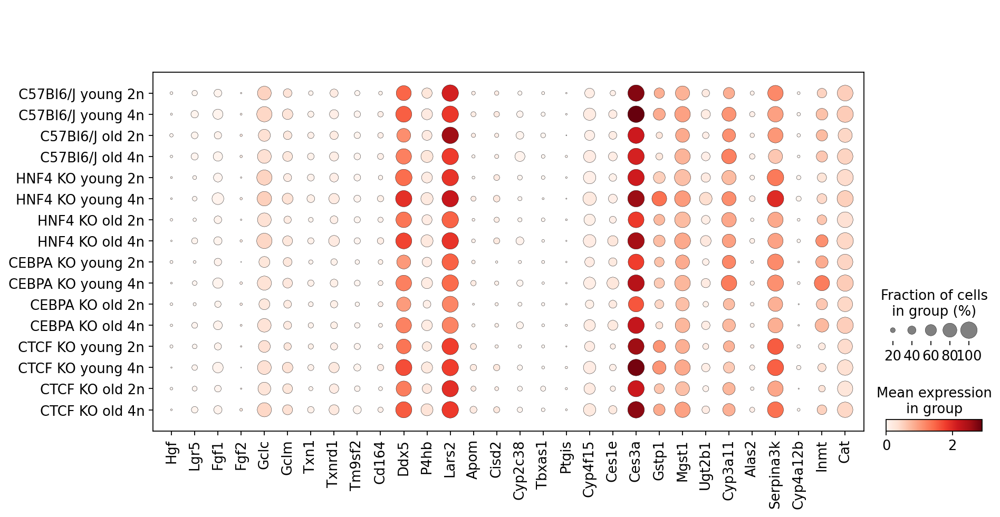

In [175]:
sc.pl.dotplot(adata_hep, #figsize=(10,7),
              gene_symbols='gene_name', 
              groupby='strain_age_ploidy', #swap_axes=True, 
              var_names = subset, vmin=0,
              #show_gene_labels=True, standard_scale='var',
              save = today + '_decrease_age_strains_age_ploidy.pdf'
             )

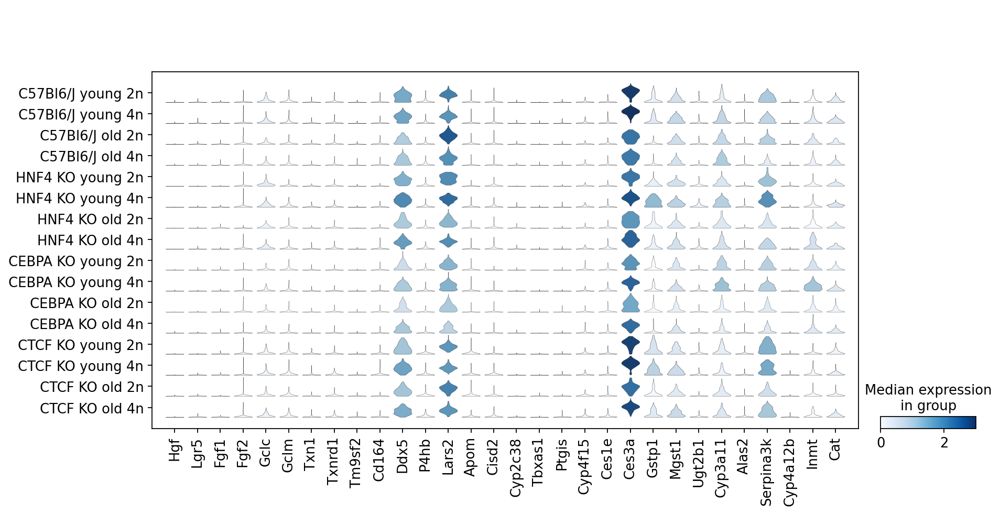

In [182]:
sc.pl.stacked_violin(adata_hep, #figsize=(10,7),
              gene_symbols='gene_name', 
              groupby='strain_age_ploidy', #swap_axes=True, 
              var_names = subset, vmin=0,
              #show_gene_labels=True, standard_scale='var',
              save = today + '_decrease_age_strains_age_ploidy.pdf'
             )

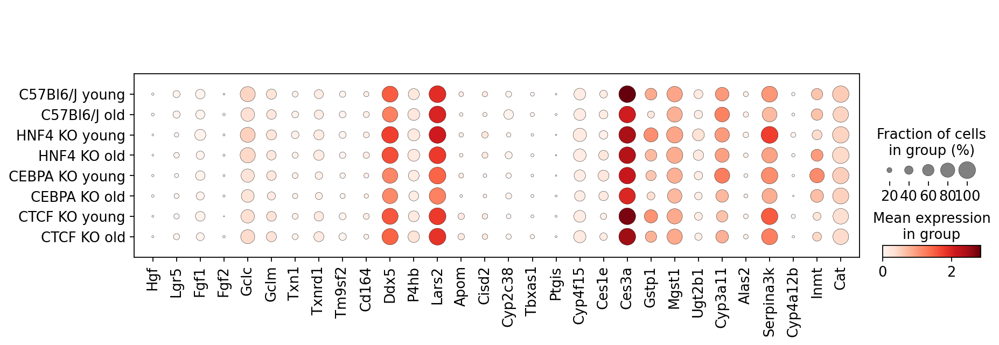

In [181]:
sc.pl.dotplot(adata_hep, #figsize=(10,7),
              gene_symbols='gene_name', 
              groupby='strain_age', #swap_axes=True, 
              var_names = subset, vmin=0,
              #show_gene_labels=True, standard_scale='var',
              save = today + '_decrease_age_strains_age.pdf'
             )

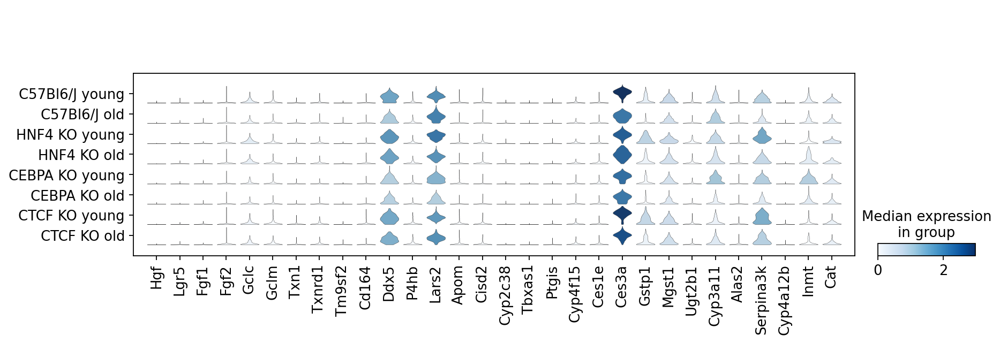

In [180]:
sc.pl.stacked_violin(adata_hep, #figsize=(10,7),
              gene_symbols='gene_name', 
              groupby='strain_age', #swap_axes=True, 
              var_names = subset, vmin=0,
              #show_gene_labels=True, standard_scale='var',
              save = today + '_decrease_age_strains_age.pdf'
             )

In [186]:
adata_hep_tmp = adata_hep[adata_hep.obs['strain']!='CTCF'].copy()

In [187]:
adata_hep_tmp

AnnData object with n_obs × n_vars = 3969 × 30520
    obs: 'batch', 'exp.', 'libraryID', 'experiment', 'strain', 'age', 'sex', 'ploidy', 'ERCC.dilution', 'column', 'row', 'percentERCC', 'n_counts', 'age_grouped', 'n_counts_raw', 'n_counts_transcripts', 'n_counts_ERCC', 'n_genes', 'high_ERCC', 'low_ERCC', 'low_genes', 'high_genes', 'low_counts', 'high_counts', 'ERCC_size_factor', 'n_counts_TPM', 'RPK_factor', 'n_counts_TPM_norm', 'mean_transcript_count_TPM', 'cyclone_phases', 'score_G1', 'score_S', 'score_G2M', 'leiden_r1', 'leiden_r02', 'low_res_ct', 'clusters', 'score_Natural killer', 'score_Lymphocyte', 'score_Hepatoblast', 'score_Endothelial', 'score_Dendritic cell', 'score_B cells', 'score_Cholangiocyte', 'score_Kupffer and Macrophage', 'score_Hepatocyte', 'score_Neutrophil', 'leidenr02_02', 'cell_type', 'hblast_marker_sum', 'cell_type1', 'age_ploidy', 'strain_age_ploidy', 'strain_age'
    var: 'gene_name', 'gene_mean'
    uns: 'ERCC.dilution_colors', 'cell_type1_colors', 'cell_typ

In [ ]:
sc.pl.correlation_matrix(adata_hep_tmp, groupby="cell_type1", save='_' + today + "_young_correlation.pdf")

# Heatmaps

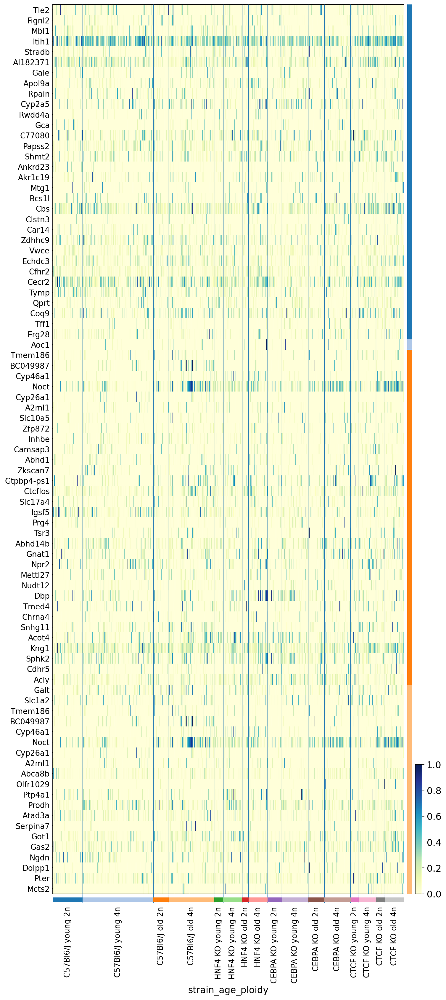

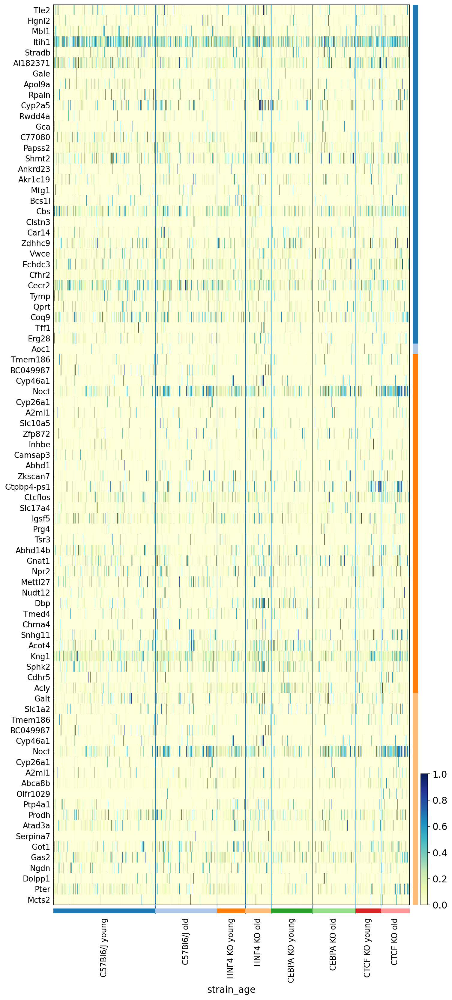

In [124]:
sc.pl.heatmap(adata_hep, figsize=(10,25),
              gene_symbols='gene_name', 
              groupby='strain_age_ploidy', swap_axes=True, 
              var_names = hm_conserved_old_dict,#['shared with cebpa'], #
              cmap='YlGnBu',
              show_gene_labels=True, standard_scale='var',
              save = today + '_conserved_old_strains_age_ploidy.pdf'
             )

sc.pl.heatmap(adata_hep, figsize=(10,25),
              gene_symbols='gene_name', 
              groupby='strain_age', swap_axes=True, 
              var_names = hm_conserved_old_dict,#['shared with cebpa'], #
              cmap='YlGnBu',
              show_gene_labels=True, standard_scale='var',
              save = today + '_conserved_old_strains_age.pdf'
             )

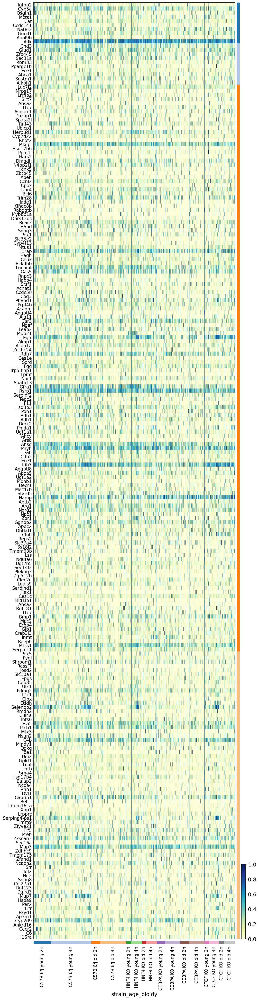

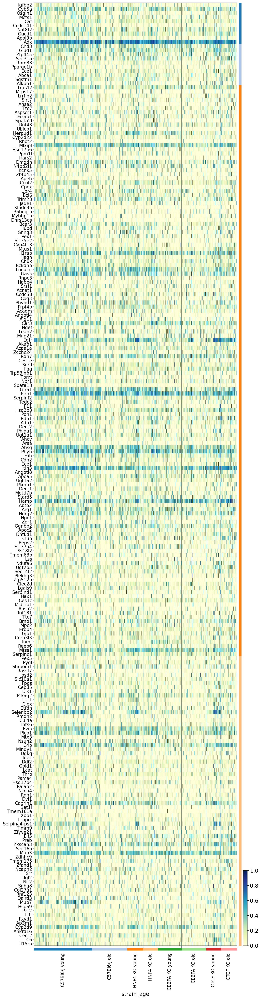

In [168]:
dict_len = 0
for keys in hm_conserved_young_dict.keys():
    dict_len = dict_len + len(hm_conserved_young_dict[keys])

figlen = dict_len/5

sc.pl.heatmap(adata_hep, figsize=(10,figlen),
              gene_symbols='gene_name', 
              groupby='strain_age_ploidy', swap_axes=True, 
              var_names = hm_conserved_young_dict,#['shared with cebpa'], #
              cmap='YlGnBu',
              show_gene_labels=True, standard_scale='var',
              save = today + '_conserved_young_strains_age_ploidy.pdf'
             )

sc.pl.heatmap(adata_hep, figsize=(10,figlen),
              gene_symbols='gene_name', 
              groupby='strain_age', swap_axes=True, 
              var_names = hm_conserved_young_dict,#['shared with cebpa'], #
              cmap='YlGnBu',
              show_gene_labels=True, standard_scale='var',
              save = today + '_conserved_young_strains_age.pdf'
             )

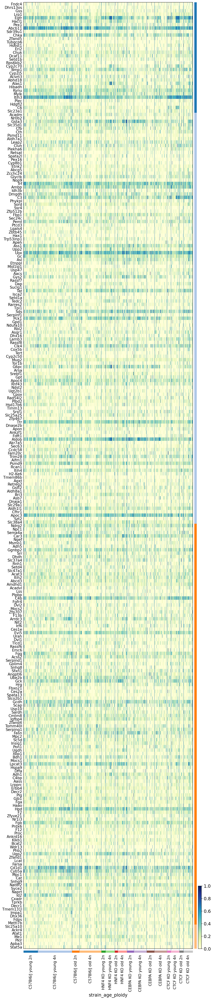

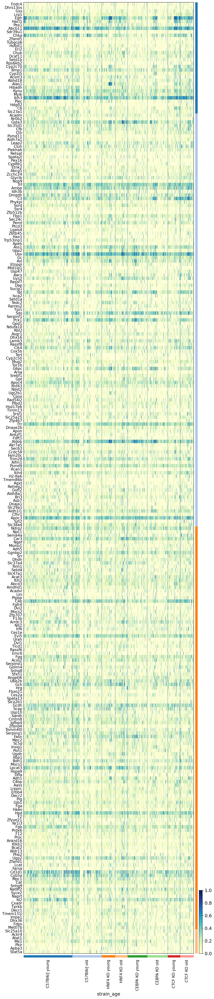

In [167]:
dict_len = 0
for keys in hm_unique_old_dict.keys():
    dict_len = dict_len + len(hm_unique_old_dict[keys])

figlen = dict_len/5
sc.pl.heatmap(adata_hep, figsize=(10,figlen),
              gene_symbols='gene_name', 
              groupby='strain_age_ploidy', swap_axes=True, 
              var_names = hm_unique_old_dict,#['shared with cebpa'], #
              cmap='YlGnBu',
              show_gene_labels=True, standard_scale='var',
              save = today + '_unique_old_strains_age_ploidy.pdf'
             )

sc.pl.heatmap(adata_hep, figsize=(10,figlen),
              gene_symbols='gene_name', 
              groupby='strain_age', swap_axes=True, 
              var_names = hm_unique_old_dict,#['shared with cebpa'], #
              cmap='YlGnBu',
              show_gene_labels=True, standard_scale='var',
              save = today + '_unique_old_strains_age.pdf'
             )

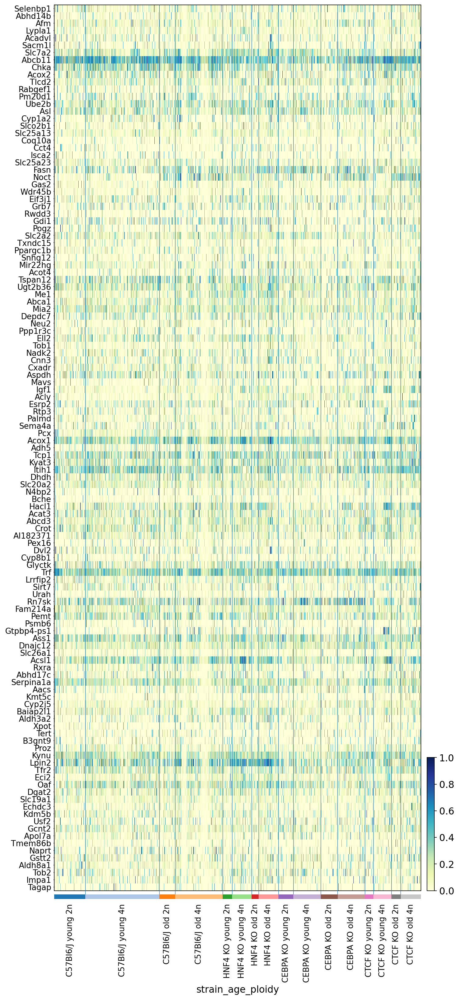

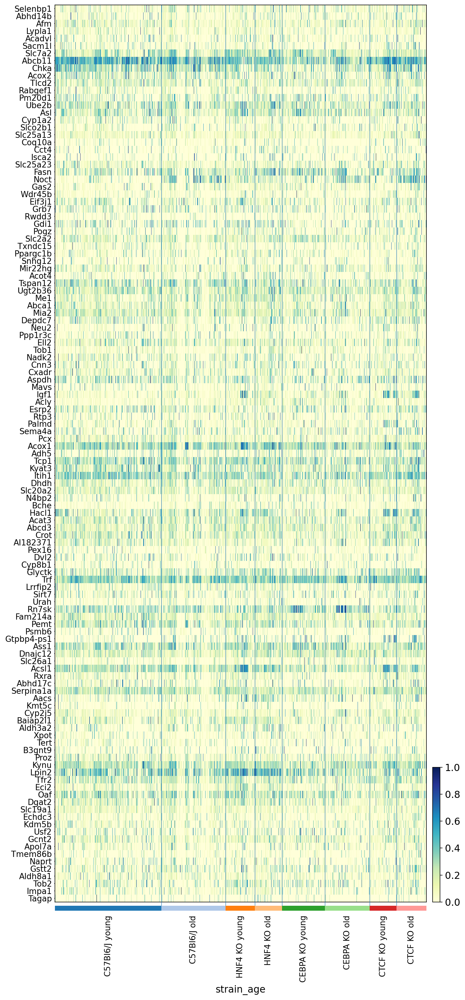

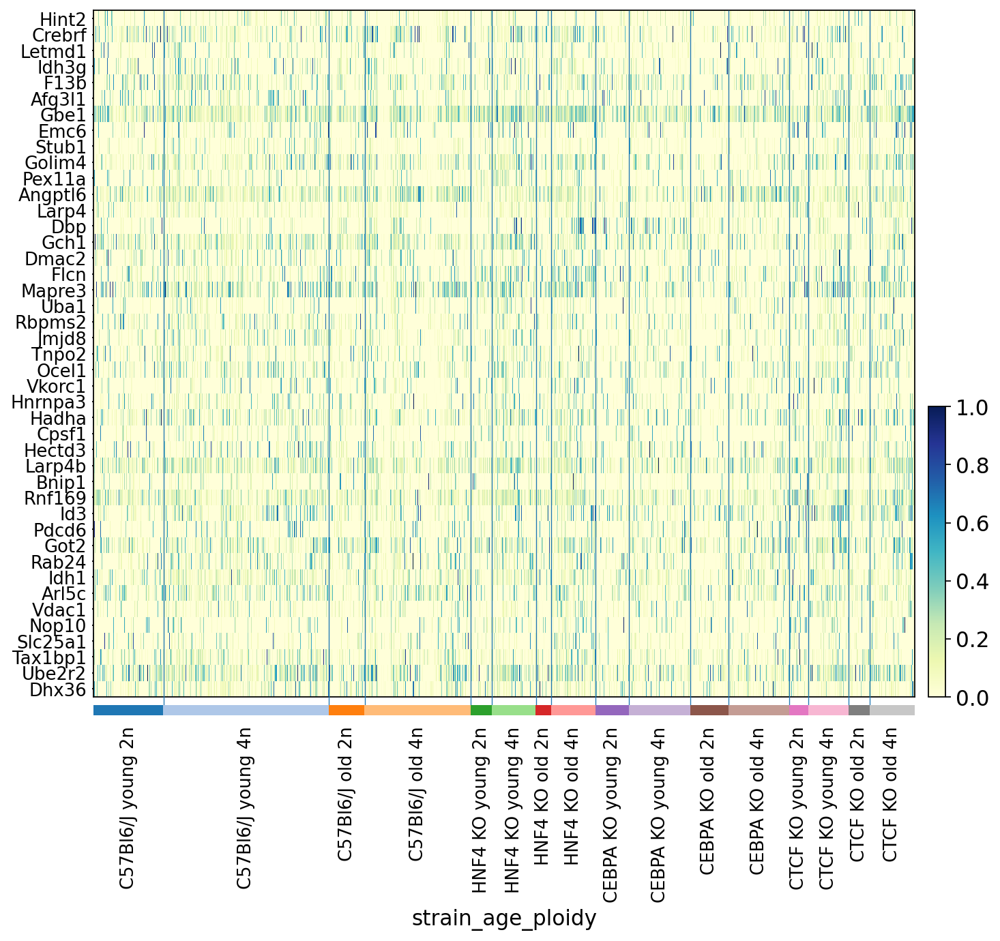

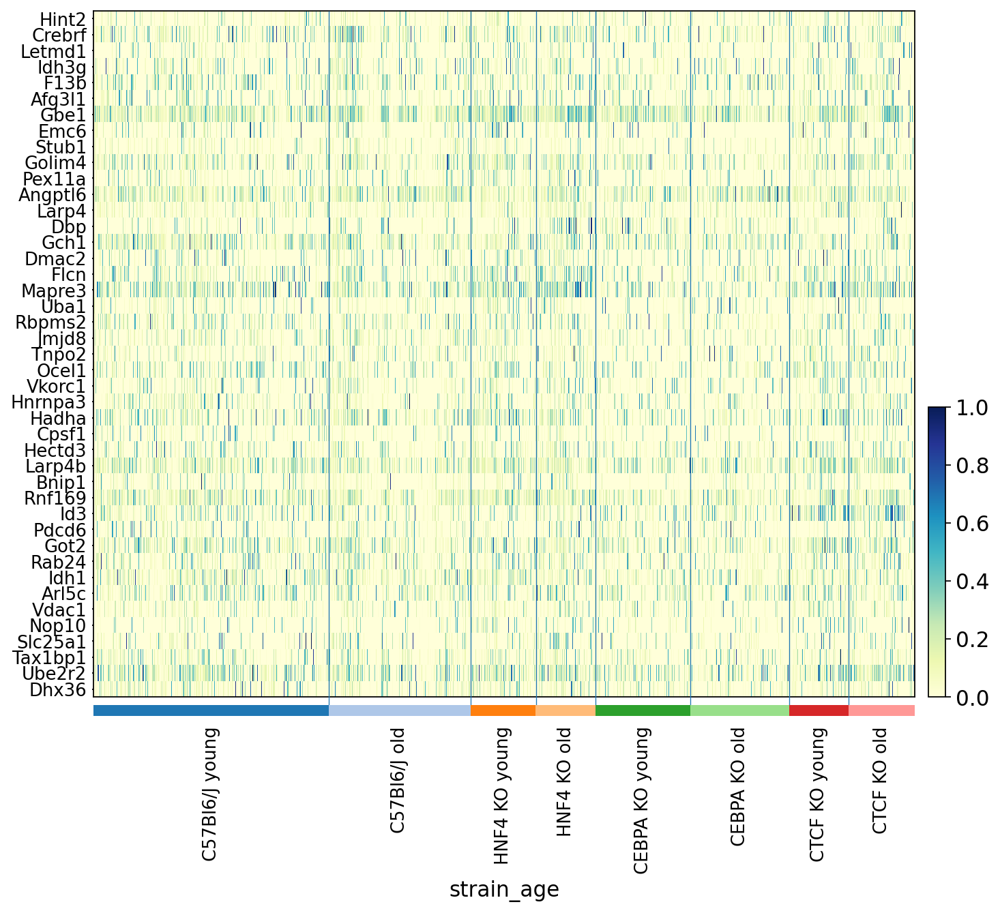

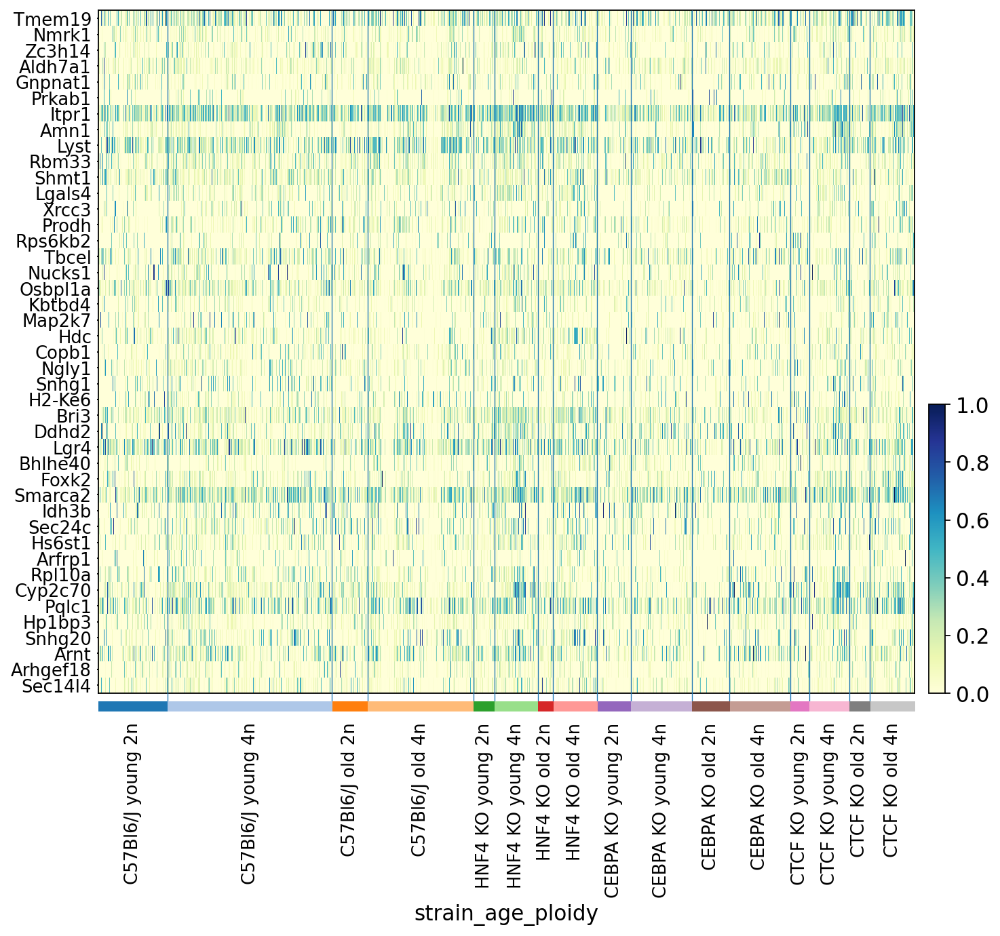

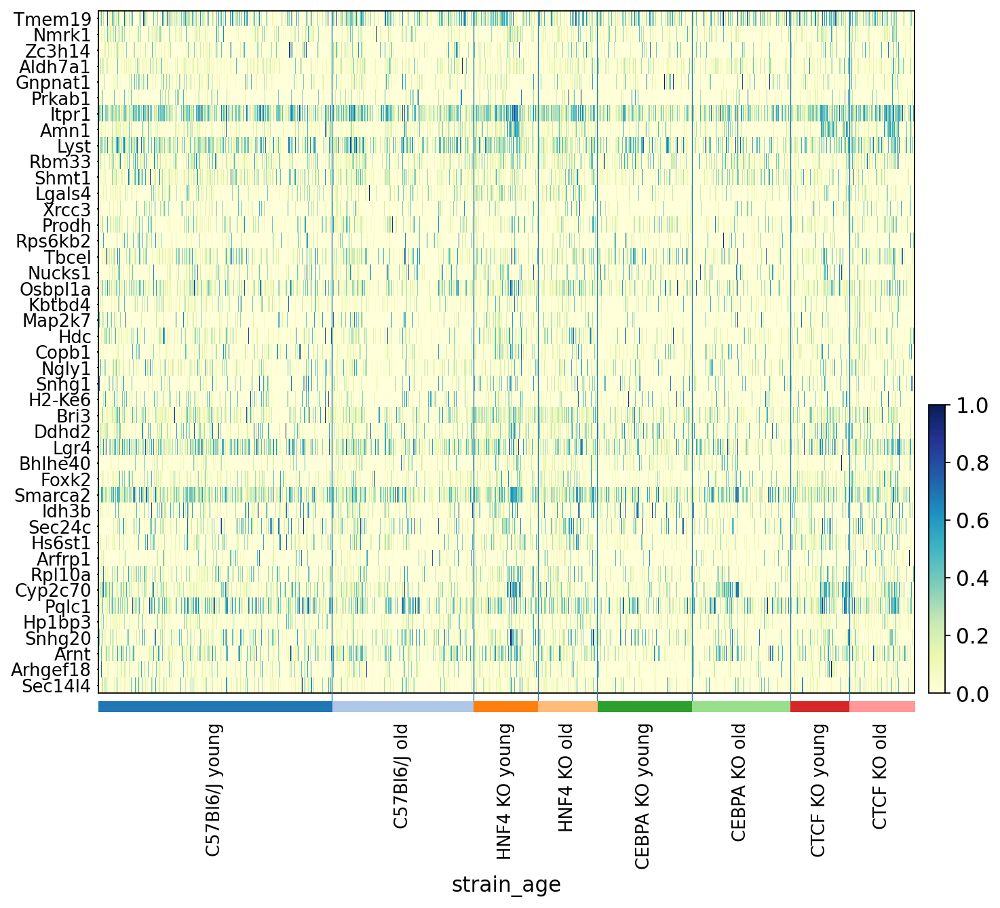

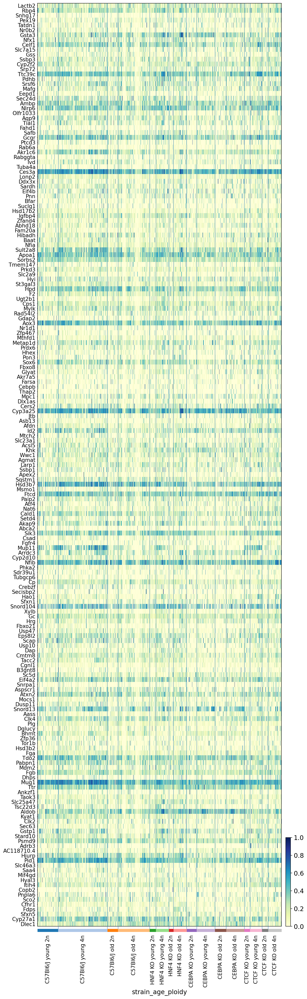

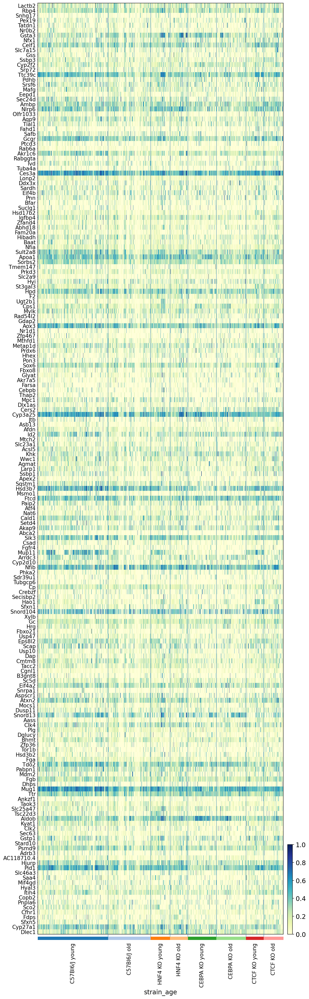

In [159]:
for keys in hm_unique_young_dict.keys():
    figlen = len(hm_unique_young_dict[keys])/5
    sc.pl.heatmap(adata_hep, figsize=(10,figlen),
              gene_symbols='gene_name', 
              groupby='strain_age_ploidy', swap_axes=True, 
              var_names = hm_unique_young_dict[keys],
              cmap='YlGnBu',
              show_gene_labels=True, standard_scale='var',
              save = today + '_unique_young_'+ keys +'_strains_age_ploidy.pdf'
             )

    sc.pl.heatmap(adata_hep, figsize=(10,figlen),
              gene_symbols='gene_name', 
              groupby='strain_age', swap_axes=True, 
              var_names = hm_unique_young_dict[keys],
              cmap='YlGnBu',
              show_gene_labels=True, standard_scale='var',
              save = today + '_unique_young_'+ keys +'_strains_age.pdf'
             )

# t-SNE plots of hepatocyte subsets

In this section, we create t-SNE plots of hepatocytes for the first figure draft: 

Fig. 2A: t-SNE plot showing only hepatocytes 

- young (B6, Hnf4a, Cebpa)  (coloured by strain?)
- old (B6, Hnf4a, Cebpa)  (coloured by strain?)
- young and old  (B6, Hnf4a, Cebpa)  (coloured by strain and age?)
- young and old  (B6, Hnf4a, Cebpa)  (coloured by ploidy?)

Fig. 3A: t-SNE plot showing only hepatocytes

- young (B6, Hnf4a, Cebpa, Ctcf)  (coloured by strain?)
- old (B6, Hnf4a, Cebpa, Ctcf)  (coloured by strain?)
- young and old  (B6, Hnf4a, Cebpa, Ctcf)  (coloured by strain and age?)
- young and old  (B6, Hnf4a, Cebpa, Ctcf)  (coloured by ploidy?)

We want to set up the following color scheme:

* Old = grey
* Young = dark grey

Then the cell types stay the same.
 
Regarding strains:

* Wild-type = black
* Hnf4 = dark brown
* Cebp = light brown - salmon colors
* Ctcf = light green

In [23]:
adata_hep.uns['strain_age_colors'] = []
adata_hep.uns['strain_age_colors'].append('#686868') #WT young 
adata_hep.uns['strain_age_colors'].append('#a9a9a9') #WT old
adata_hep.uns['strain_age_colors'].append('#8B4C39') #HNF4 young - salmon4 color
adata_hep.uns['strain_age_colors'].append('#BE7F6C') #HNF4 old
adata_hep.uns['strain_age_colors'].append('#EE8262') #CEBPA young - salmon2 color
adata_hep.uns['strain_age_colors'].append('#FFB595') #CEBPA old
adata_hep.uns['strain_age_colors'].append('#26a2b5') #CTCF young - blueish color
adata_hep.uns['strain_age_colors'].append('#59E5F8') #CTCF old

In [24]:
adata_hep

AnnData object with n_obs × n_vars = 3969 × 30520
    obs: 'batch', 'exp.', 'libraryID', 'experiment', 'strain', 'age', 'sex', 'ploidy', 'ERCC.dilution', 'column', 'row', 'percentERCC', 'n_counts', 'age_grouped', 'n_counts_raw', 'n_counts_transcripts', 'n_counts_ERCC', 'n_genes', 'high_ERCC', 'low_ERCC', 'low_genes', 'high_genes', 'low_counts', 'high_counts', 'ERCC_size_factor', 'n_counts_TPM', 'RPK_factor', 'n_counts_TPM_norm', 'mean_transcript_count_TPM', 'cyclone_phases', 'score_G1', 'score_S', 'score_G2M', 'leiden_r1', 'leiden_r02', 'low_res_ct', 'clusters', 'score_Natural killer', 'score_Lymphocyte', 'score_Hepatoblast', 'score_Endothelial', 'score_Dendritic cell', 'score_B cells', 'score_Cholangiocyte', 'score_Kupffer and Macrophage', 'score_Hepatocyte', 'score_Neutrophil', 'leidenr02_02', 'cell_type', 'hblast_marker_sum', 'cell_type1', 'age_ploidy', 'strain_age_ploidy', 'strain_age'
    var: 'gene_name'
    uns: 'ERCC.dilution_colors', 'age_colors', 'age_grouped_colors', 'cell_t

## Fig. 3A 

Compute a t-SNE of all hepatocytes.

In [25]:
sc.pp.pca(adata_hep)
sc.pp.neighbors(adata_hep)
sc.tl.tsne(adata_hep, perplexity=30, n_pcs=10)

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


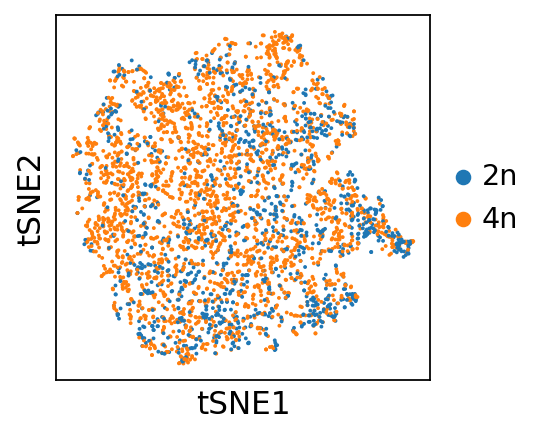

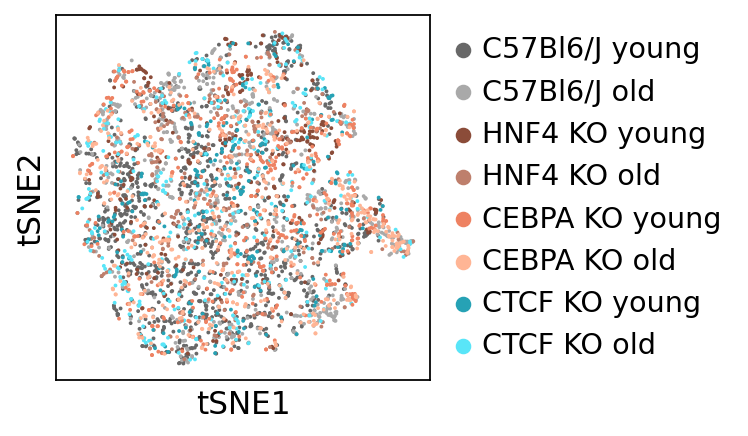

In [26]:
rcParams['figure.figsize']=(3,3)
color_keys = ['ploidy', 'strain_age']
for keys in color_keys:
    sc.pl.tsne(adata_hep, color=keys, title ='',size=12,
               save = today + '_' + keys + '_all_hepatocytes.pdf' 
              )

Subset to old and young hepatocytes, resp., and recompute t-SNE.

In [28]:
 adata_age.obs['strain'].cat.categories

Index(['C57Bl6/J', 'CEBPA KO', 'CTCF KO', 'HNF4 KO'], dtype='object')

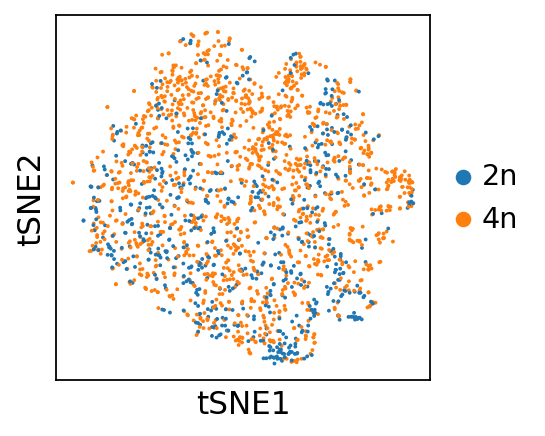

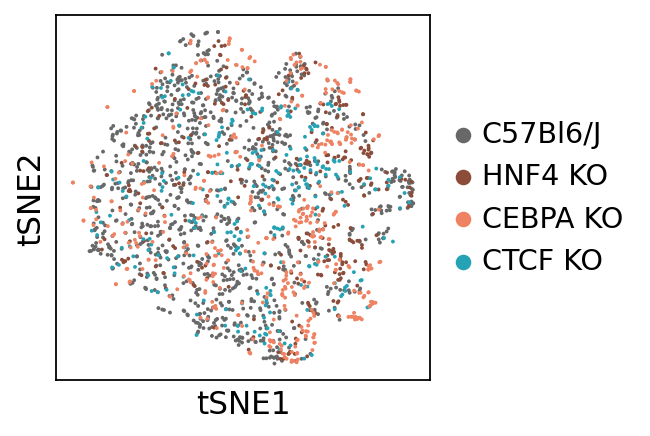

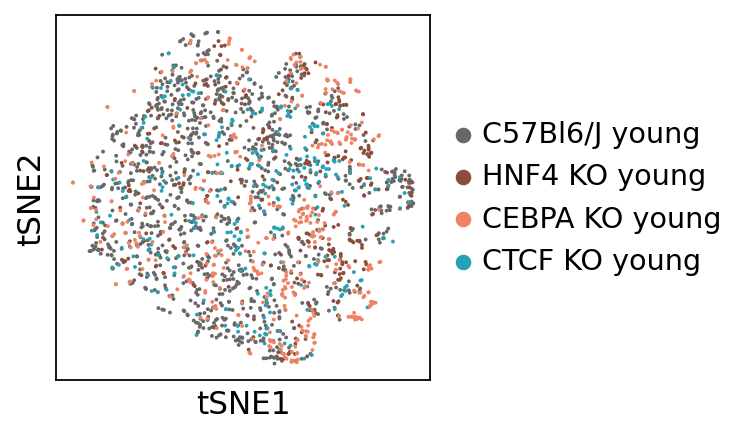

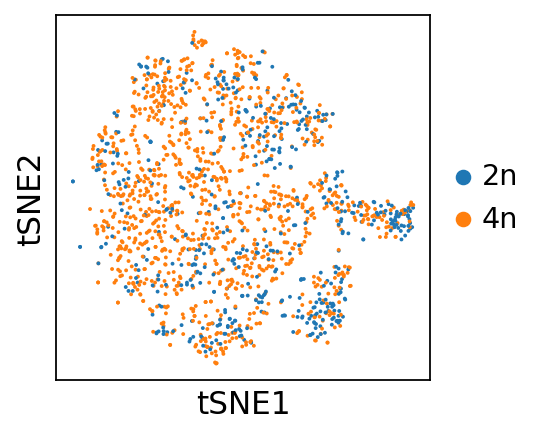

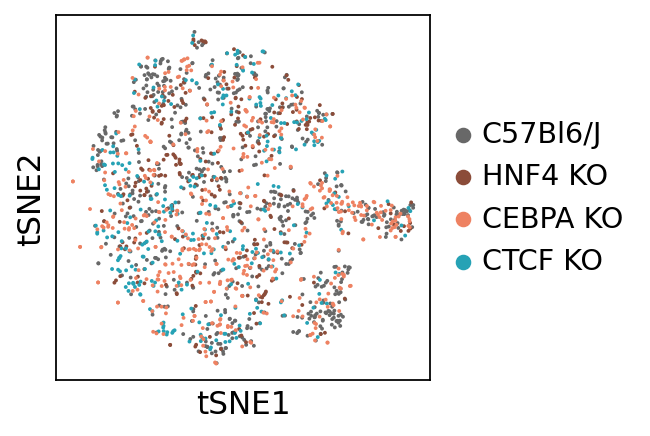

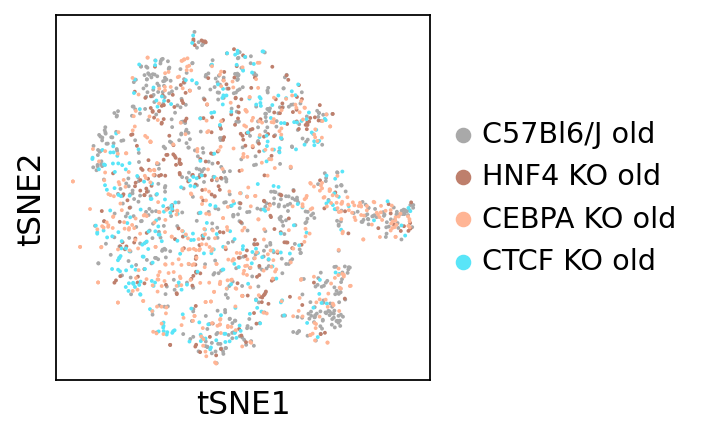

In [29]:
for age_group in ['young', 'old']:
    adata_age = adata_hep[adata_hep.obs['age_grouped']==age_group].copy()
    #set color scheme
    adata_age.uns['strain_colors'] = []
    adata_age.uns['strain_colors'].append('#686868') #WT young 
    adata_age.uns['strain_colors'].append('#8B4C39') #HNF4 young - salmon4 color
    adata_age.uns['strain_colors'].append('#EE8262') #CEBPA young - salmon2 color

    adata_age.uns['strain_colors'].append('#26a2b5') #CTCF young - blueish color
    #set categories correctly
    adata_age.obs['strain'] =  adata_age.obs['strain'].cat.reorder_categories([
        'C57Bl6/J','HNF4 KO', 'CEBPA KO',  'CTCF KO'])
    
    
    #recompute embedding
    sc.pp.pca(adata_age)
    sc.pp.neighbors(adata_age)
    sc.tl.tsne(adata_age, perplexity=30, n_pcs=10)
    #create t-SNE plots
    rcParams['figure.figsize']=(3,3)
    color_keys = ['ploidy', 'strain', 'strain_age']
    for keys in color_keys:
        sc.pl.tsne(adata_age, color=keys, title ='',size=12,
               save = today + '_' + keys + '_all_' + age_group + '_hepatocytes.pdf' 
              )

## Fig. 2A

Exclude CTCF strain and recompute t-SNEs as in Fig. 3A.

In [31]:
adata_hep_spec = adata_hep[adata_hep.obs['strain'] != 'CTCF KO'].copy()

Recompute t-SNE for all cells.

In [32]:
sc.pp.pca(adata_hep_spec)
sc.pp.neighbors(adata_hep_spec)
sc.tl.tsne(adata_hep_spec, perplexity=30, n_pcs=10)

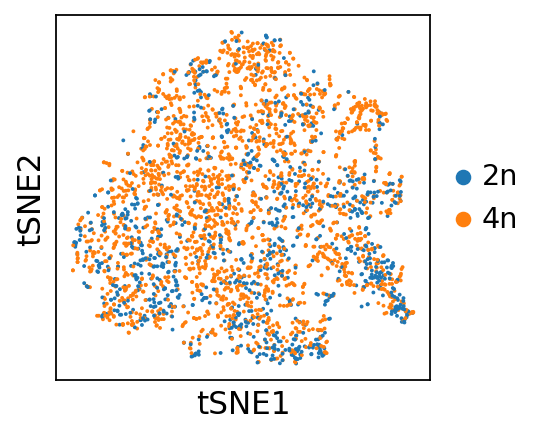

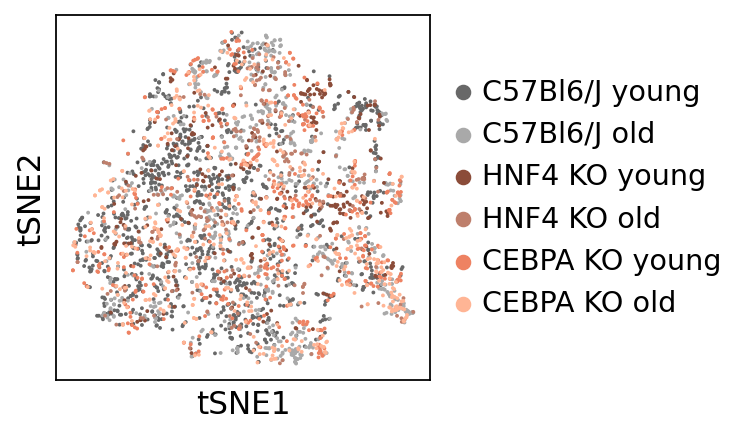

In [33]:
rcParams['figure.figsize']=(3,3)
color_keys = ['ploidy', 'strain_age']
for keys in color_keys:
    sc.pl.tsne(adata_hep_spec, color=keys, title ='',size=12,
               save = today + '_' + keys + '_woCTCF_hepatocytes.pdf' 
              )

Subset to old and young hepatocytes, resp., and recompute t-SNE.

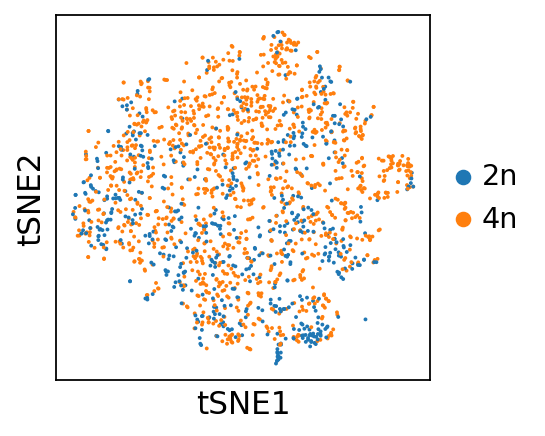

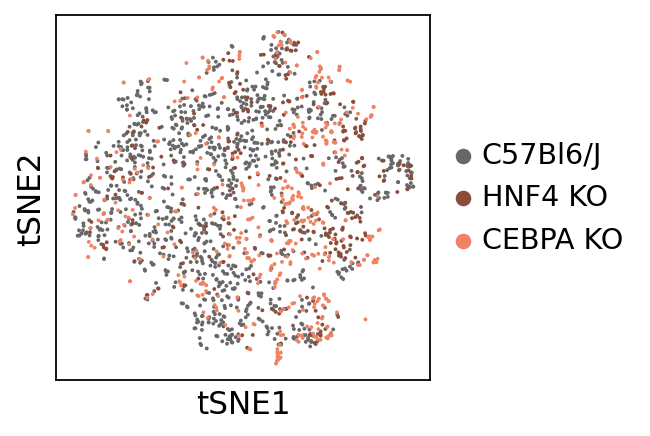

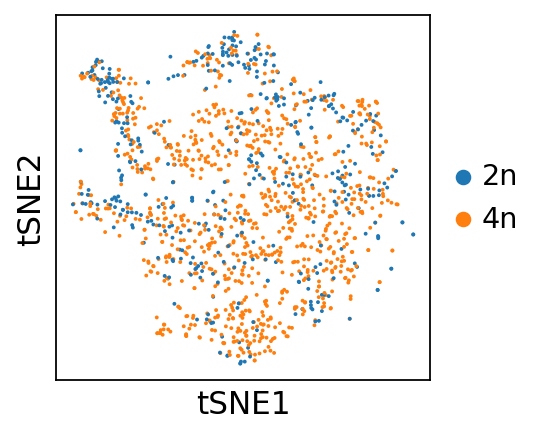

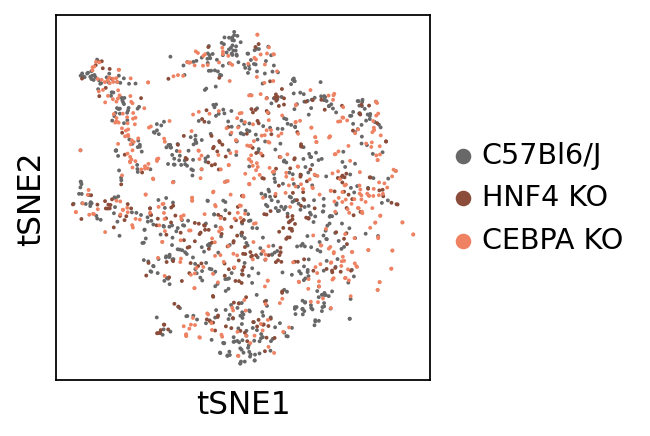

In [34]:
for age_group in ['young', 'old']:
    adata_age = adata_hep_spec[adata_hep_spec.obs['age_grouped']==age_group].copy()
    #set color scheme
    adata_age.uns['strain_colors'] = []
    adata_age.uns['strain_colors'].append('#686868') #WT young 
    adata_age.uns['strain_colors'].append('#8B4C39') #HNF4 young - salmon4 color
    adata_age.uns['strain_colors'].append('#EE8262') #CEBPA young - salmon2 color
    #set categories correctly
    adata_age.obs['strain'] =  adata_age.obs['strain'].cat.reorder_categories([
        'C57Bl6/J','HNF4 KO', 'CEBPA KO'])

    #recompute embedding
    sc.pp.pca(adata_age)
    sc.pp.neighbors(adata_age)
    sc.tl.tsne(adata_age, perplexity=30, n_pcs=10)
    #create t-SNE plots
    rcParams['figure.figsize']=(3,3)
    color_keys = ['ploidy', 'strain']
    for keys in color_keys:
        sc.pl.tsne(adata_age, color=keys, title ='',size=12,
               save = today + '_' + keys + '_woCTCF_' + age_group + '_hepatocytes.pdf' 
              )

## Matrixplot for unchanged genes

* If possible, could we please use a colour scheme of blue (down) to red (up).
* For x axis, please list them as young-wt, young-Hnf4a, young-Cebpa, young-Ctcf, old-wt, old-Hnf4a, old-Cebpa, old-Ctcf
* Please feel free to apply more filter where you think it is appropriate.

In [74]:
adata_hep.obs['strain_age'] = adata_hep.obs['strain_age'].cat.reorder_categories(
    ['C57Bl6/J young', 'HNF4 KO young',
     'CEBPA KO young','CTCF KO young',
     'C57Bl6/J old', 'HNF4 KO old', 
     'CEBPA KO old', 'CTCF KO old']
)

In [81]:
adata_hep.var['gene_name']

ENSMUSG00000000001         Gnai3
ENSMUSG00000000028         Cdc45
ENSMUSG00000000037         Scml2
ENSMUSG00000000049          Apoh
ENSMUSG00000000056          Narf
                         ...    
ENSMUSG00000116987    AC150035.3
ENSMUSG00000116988    AC164314.2
ENSMUSG00000116992    AC183097.4
ENSMUSG00000116993    AC135964.2
ENSMUSG00000116995    AC110534.5
Name: gene_name, Length: 30520, dtype: category
Categories (30489, object): ['0610005C13Rik', '0610006L08Rik', '0610009B22Rik', '0610009E02Rik', ..., 'n-R5s156', 'n-R5s162', 'n-R5s167', 'n-R5s195']

In [ ]:
sc.pl.matrixplot(adata_hep, groupby = 'strain_age', 
                 gene_symbols = 'gene_name', 
                 use_raw=False,
                 var_names = unchanged_genes['Genes'],
                 standard_scale = 'var',
                 cmap = 'RdBu_r')